In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import warnings
warnings.filterwarnings('ignore')

# **AirBNB_NYC_2019**

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')
df=pd.read_csv('gdrive/My Drive/colab_datasets/AB_NYC_2019.csv')
df

Mounted at /content/gdrive


,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48890,36484665,Charming one bedroom - newly renovated rowhouse,8232441,Sabrina,Brooklyn,Bedford-Stuyvesant,40.67853,-73.94995,Private room,70,2,0,NaN,NaN,2,9
48891,36485057,Affordable room in Bushwick/East Williamsburg,6570630,Marisol,Brooklyn,Bushwick,40.70184,-73.93317,Private room,40,4,0,NaN,NaN,2,36
48892,36485431,Sunny Studio at Historical Neighborhood,23492952,Ilgar & Aysel,Manhattan,Harlem,40.81475,-73.94867,Entire home/apt,115,10,0,NaN,NaN,1,27
48893,36485609,43rd St. Time Square-cozy single bed,30985759,Taz,Manhattan,Hell's Kitchen,40.75751,-73.99112,Shared room,55,1,0,NaN,NaN,6,2


In [ ]:
missing_values = df.isnull().sum()
print(missing_values)

id                                    0
name                                 16
host_id                               0
host_name                            21
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                 10052
calculated_host_listings_count        0
availability_365                      0
dtype: int64


In [ ]:
#Quantitative data upon which Numerical data measures can be performed: price, minimum_nights, number_of_reviews, reviews_per_month, calculated_host_listings_count, availability_365

In [ ]:
columns = ['price', 'minimum_nights', 'number_of_reviews', 'reviews_per_month', 'calculated_host_listings_count', 'availability_365']
df[columns].describe()

,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,48895.000000,48895.000000,48895.000000,38843.000000,48895.000000,48895.000000
mean,152.720687,7.029962,23.274466,1.373221,7.143982,112.781327
std,240.154170,20.510550,44.550582,1.680442,32.952519,131.622289
min,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000
25%,69.000000,1.000000,1.000000,0.190000,1.000000,0.000000
50%,106.000000,3.000000,5.000000,0.720000,1.000000,45.000000
75%,175.000000,5.000000,24.000000,2.020000,2.000000,227.000000
max,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


## **1. Measures of Central Tendency**

In [ ]:
mean = df[columns].mean()
mean

,0
price,152.720687
minimum_nights,7.029962
number_of_reviews,23.274466
reviews_per_month,1.373221
calculated_host_listings_count,7.143982
availability_365,112.781327


In [ ]:
median = df[columns].median()
median

,0
price,106.00
minimum_nights,3.00
number_of_reviews,5.00
reviews_per_month,0.72
calculated_host_listings_count,1.00
availability_365,45.00


In [ ]:
mode = df[columns].mode().iloc[0]
mode

,0
price,100.00
minimum_nights,1.00
number_of_reviews,0.00
reviews_per_month,0.02
calculated_host_listings_count,1.00
availability_365,0.00


## **2.Measures of Dispersion (Variability)**

In [ ]:
range = df[columns].max() - df[columns].min()
range

,0
price,10000.00
minimum_nights,1249.00
number_of_reviews,629.00
reviews_per_month,58.49
calculated_host_listings_count,326.00
availability_365,365.00


In [ ]:
variance = df[columns].var()
variance

,0
price,57674.025247
minimum_nights,420.682642
number_of_reviews,1984.754380
reviews_per_month,2.823885
calculated_host_listings_count,1085.868499
availability_365,17324.426923


In [ ]:
standard_deviation = df[columns].std()
standard_deviation

,0
price,240.154170
minimum_nights,20.510550
number_of_reviews,44.550582
reviews_per_month,1.680442
calculated_host_listings_count,32.952519
availability_365,131.622289


In [ ]:
Interquartile_range = df[columns].quantile(0.75) - df[columns].quantile(0.25)
Interquartile_range

,0
price,106.00
minimum_nights,4.00
number_of_reviews,23.00
reviews_per_month,1.83
calculated_host_listings_count,1.00
availability_365,227.00


## **3. Shape of the Distribution**

In [ ]:
skewness = df[columns].skew()
skewness

,0
price,19.118939
minimum_nights,21.827275
number_of_reviews,3.690635
reviews_per_month,3.130189
calculated_host_listings_count,7.933174
availability_365,0.763408


In [ ]:
kurtosis = df[columns].kurtosis()
kurtosis

,0
price,585.672879
minimum_nights,854.071662
number_of_reviews,19.529788
reviews_per_month,42.493469
calculated_host_listings_count,67.550888
availability_365,-0.997534


## **4. Measures of Position**

In [ ]:
percentiles = df[columns].quantile([0.1, 0.25, 0.5, 0.75, 0.9])
percentiles

,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
0.10,49.0,1.0,0.0,0.06,1.0,0.0
0.25,69.0,1.0,1.0,0.19,1.0,0.0
0.50,106.0,3.0,5.0,0.72,1.0,45.0
0.75,175.0,5.0,24.0,2.02,2.0,227.0
0.90,269.0,28.0,70.0,3.63,5.0,337.0


In [ ]:
quartiles = df[columns].quantile([0.25, 0.5, 0.75])
quartiles

,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
0.25,69.0,1.0,1.0,0.19,1.0,0.0
0.50,106.0,3.0,5.0,0.72,1.0,45.0
0.75,175.0,5.0,24.0,2.02,2.0,227.0


In [ ]:
z_scores = (df[columns] - df[columns].mean()) / df[columns].std()
z_scores

,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
0,-0.015493,-0.293993,-0.320410,-0.692212,-0.034716,1.916231
1,0.300970,-0.293993,0.487660,-0.591048,-0.156103,1.840256
2,-0.011329,-0.196482,-0.522428,NaN,-0.186450,1.916231
3,-0.265332,-0.293993,5.538099,1.944000,-0.186450,0.617059
4,-0.302808,0.144805,-0.320410,-0.757671,-0.186450,-0.856856
...,...,...,...,...,...,...
48890,-0.344448,-0.245238,-0.522428,NaN,-0.156103,-0.788478
48891,-0.469368,-0.147727,-0.522428,NaN,-0.156103,-0.583346
48892,-0.157069,0.144805,-0.522428,NaN,-0.186450,-0.651723
48893,-0.406908,-0.293993,-0.522428,NaN,-0.034716,-0.841661


## **5. Frequency Distribution**

In [ ]:
freq_tables = df[columns].value_counts()
freq_tables

price  minimum_nights  number_of_reviews  reviews_per_month  calculated_host_listings_count  availability_365
150    1               1                  0.02               1                               0                   22
75     1               1                  0.02               1                               0                   18
50     1               1                  0.02               1                               0                   17
100    1               1                  0.02               1                               0                   16
45     1               1                  0.02               1                               0                   16
                                                                                                                 ..
80     2               6                  0.53               1                               0                    1
                       7                  0.15               1                               0                    1
                                          0.21               8                               189                  1
                                          0.23               1                               0                    1
10000  100             2                  0.04               1                               0                    1
Name: count, Length: 37516, dtype: int64

In [ ]:
relative_freq_tables = df[columns].value_counts(normalize=True)
relative_freq_tables

price  minimum_nights  number_of_reviews  reviews_per_month  calculated_host_listings_count  availability_365
150    1               1                  0.02               1                               0                   0.000566
75     1               1                  0.02               1                               0                   0.000463
50     1               1                  0.02               1                               0                   0.000438
100    1               1                  0.02               1                               0                   0.000412
45     1               1                  0.02               1                               0                   0.000412
                                                                                                                   ...   
80     2               6                  0.53               1                               0                   0.000026
                       7                  0.15               1                               0                   0.000026
                                          0.21               8                               189                 0.000026
                                          0.23               1                               0                   0.000026
10000  100             2                  0.04               1                               0                   0.000026
Name: proportion, Length: 37516, dtype: float64

In [ ]:
cumulative_freq_tables = df[columns].value_counts().cumsum()
cumulative_freq_tables

price  minimum_nights  number_of_reviews  reviews_per_month  calculated_host_listings_count  availability_365
150    1               1                  0.02               1                               0                      22
75     1               1                  0.02               1                               0                      40
50     1               1                  0.02               1                               0                      57
100    1               1                  0.02               1                               0                      73
45     1               1                  0.02               1                               0                      89
                                                                                                                 ...  
80     2               6                  0.53               1                               0                   38839
                       7                  0.15               1                               0                   38840
                                          0.21               8                               189                 38841
                                          0.23               1                               0                   38842
10000  100             2                  0.04               1                               0                   38843
Name: count, Length: 37516, dtype: int64

### **For each column**

freq

In [ ]:
for column in columns:
  freq_tab=df[column].value_counts()
  print(freq_tab)
  print(" \n")

price
100    2051
150    2047
50     1534
60     1458
200    1401
       ... 
780       1
386       1
888       1
483       1
338       1
Name: count, Length: 674, dtype: int64
 

minimum_nights
1      12720
2      11696
3       7999
30      3760
4       3303
       ...  
186        1
366        1
68         1
87         1
36         1
Name: count, Length: 109, dtype: int64
 

number_of_reviews
0      10052
1       5244
2       3465
3       2520
4       1994
       ...  
313        1
540        1
480        1
326        1
341        1
Name: count, Length: 394, dtype: int64
 

reviews_per_month
0.02     919
0.05     893
1.00     893
0.03     804
0.16     667
        ... 
9.53       1
9.74       1
6.06       1
8.25       1
10.54      1
Name: count, Length: 937, dtype: int64
 

calculated_host_listings_count
1      32303
2       6658
3       2853
4       1440
5        845
6        570
8        416
7        399
327      327
9        234
232      232
10       210
96       192
12       180
1

In [ ]:
for column in columns:
  freq_tab=df[column].value_counts(normalize=True) #rel freq
  print(freq_tab)
  print(" \n")

price
100    0.041947
150    0.041865
50     0.031373
60     0.029819
200    0.028653
         ...   
780    0.000020
386    0.000020
888    0.000020
483    0.000020
338    0.000020
Name: proportion, Length: 674, dtype: float64
 

minimum_nights
1      0.260149
2      0.239206
3      0.163595
30     0.076899
4      0.067553
         ...   
186    0.000020
366    0.000020
68     0.000020
87     0.000020
36     0.000020
Name: proportion, Length: 109, dtype: float64
 

number_of_reviews
0      0.205583
1      0.107250
2      0.070866
3      0.051539
4      0.040781
         ...   
313    0.000020
540    0.000020
480    0.000020
326    0.000020
341    0.000020
Name: proportion, Length: 394, dtype: float64
 

reviews_per_month
0.02     0.023659
0.05     0.022990
1.00     0.022990
0.03     0.020699
0.16     0.017172
           ...   
9.53     0.000026
9.74     0.000026
6.06     0.000026
8.25     0.000026
10.54    0.000026
Name: proportion, Length: 937, dtype: float64
 

calculated_host_listi

cumulative freq

In [ ]:
for column in columns:
  freq_tab=df[column].value_counts().cumsum() #cumulative freq
  print(freq_tab)
  print(" \n")

price
100     2051
150     4098
50      5632
60      7090
200     8491
       ...  
780    48891
386    48892
888    48893
483    48894
338    48895
Name: count, Length: 674, dtype: int64
 

minimum_nights
1      12720
2      24416
3      32415
30     36175
4      39478
       ...  
186    48891
366    48892
68     48893
87     48894
36     48895
Name: count, Length: 109, dtype: int64
 

number_of_reviews
0      10052
1      15296
2      18761
3      21281
4      23275
       ...  
313    48891
540    48892
480    48893
326    48894
341    48895
Name: count, Length: 394, dtype: int64
 

reviews_per_month
0.02       919
0.05      1812
1.00      2705
0.03      3509
0.16      4176
         ...  
9.53     38839
9.74     38840
6.06     38841
8.25     38842
10.54    38843
Name: count, Length: 937, dtype: int64
 

calculated_host_listings_count
1      32303
2      38961
3      41814
4      43254
5      44099
6      44669
8      45085
7      45484
327    45811
9      46045
232    46277
10     

## **6. Data Visualization**

In [ ]:
plt.figure(figsize=(15,10))

<Figure size 1500x1000 with 0 Axes>

<Figure size 1500x1000 with 0 Axes>

### **Histograms**

Text(0.5, 0.98, 'Histograms')

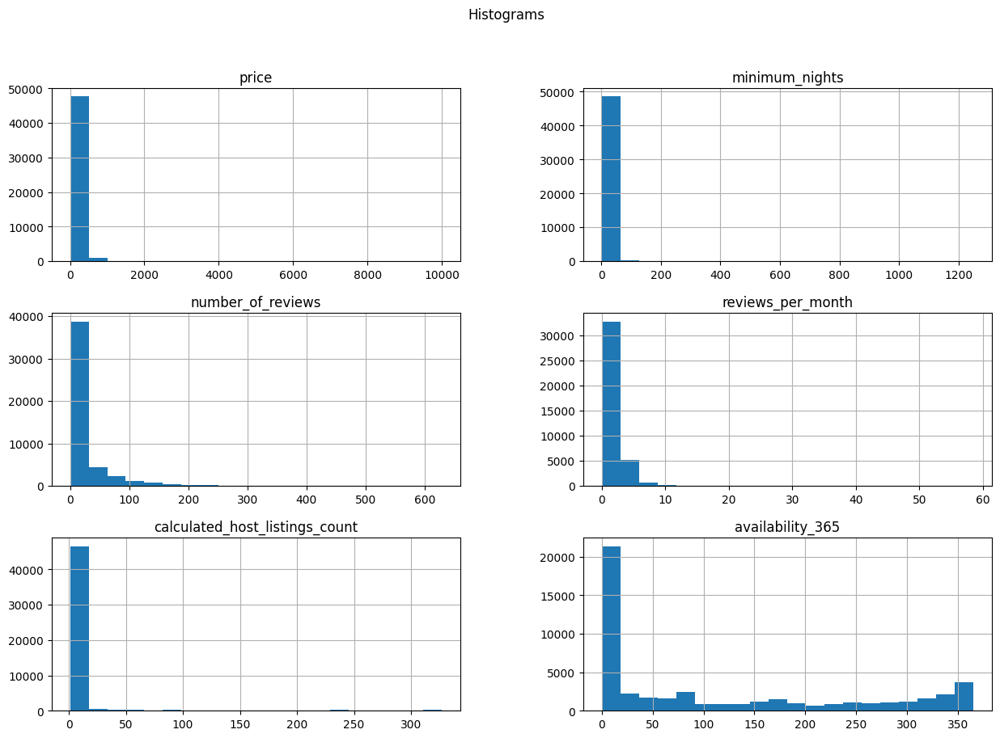

In [ ]:
df[columns].hist(bins=20, figsize=(15,10))
plt.suptitle('Histograms')

### **Box Plots**

Text(0.5, 1.0, 'Box Plots')

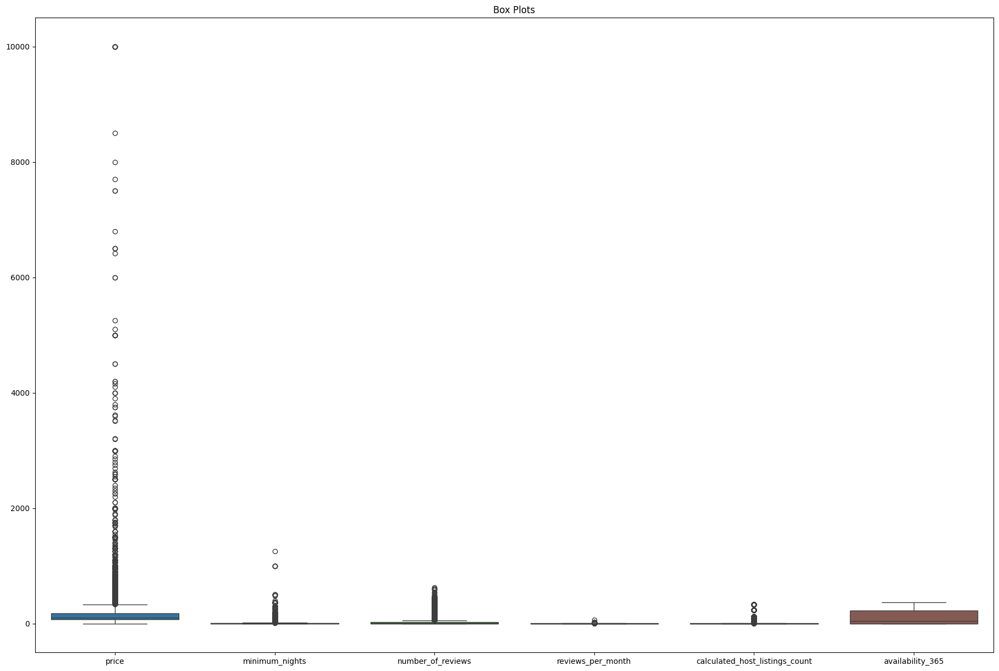

In [ ]:
plt.figure(figsize=(22.5, 15))
sns.boxplot(data=df[columns])
plt.title('Box Plots')

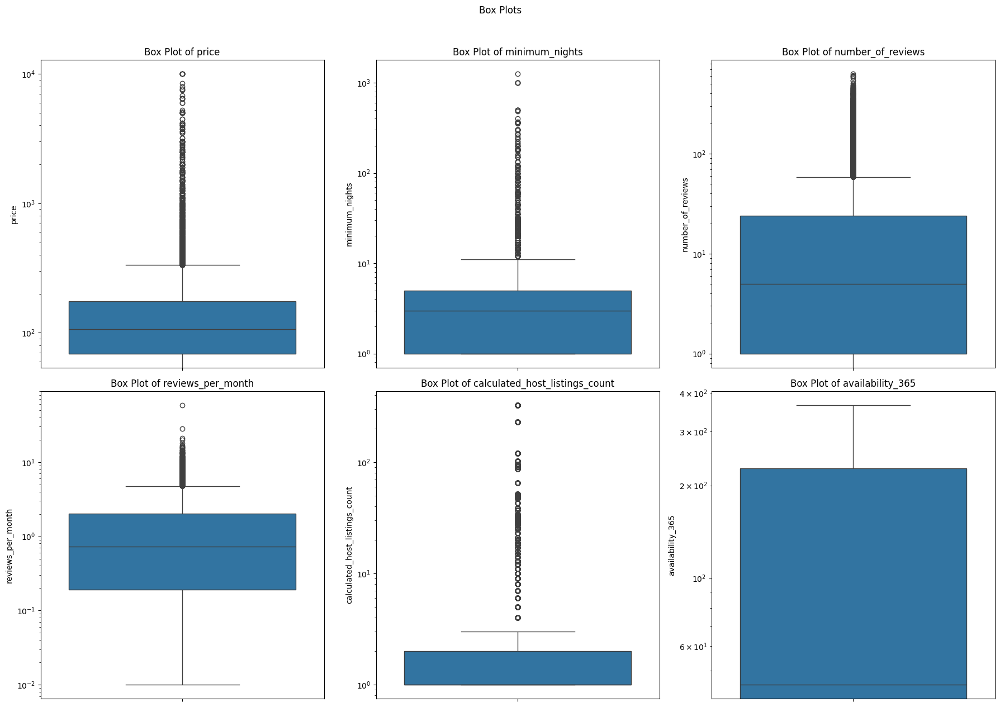

In [ ]:
plt.figure(figsize=(18, 12))

# Loop through each column to create individual subplots
for i, col in enumerate(columns, start=1):
    plt.subplot(2, 3, i)  # Adjust subplot grid if you have more or fewer columns
    sns.boxplot(y=df[col])
    plt.title(f'Box Plot of {col}')
    plt.yscale('log')  # Apply log scale to y-axis if necessary

plt.tight_layout()
plt.suptitle('Box Plots', y=1.05)
plt.show()


### **Bar Charts**

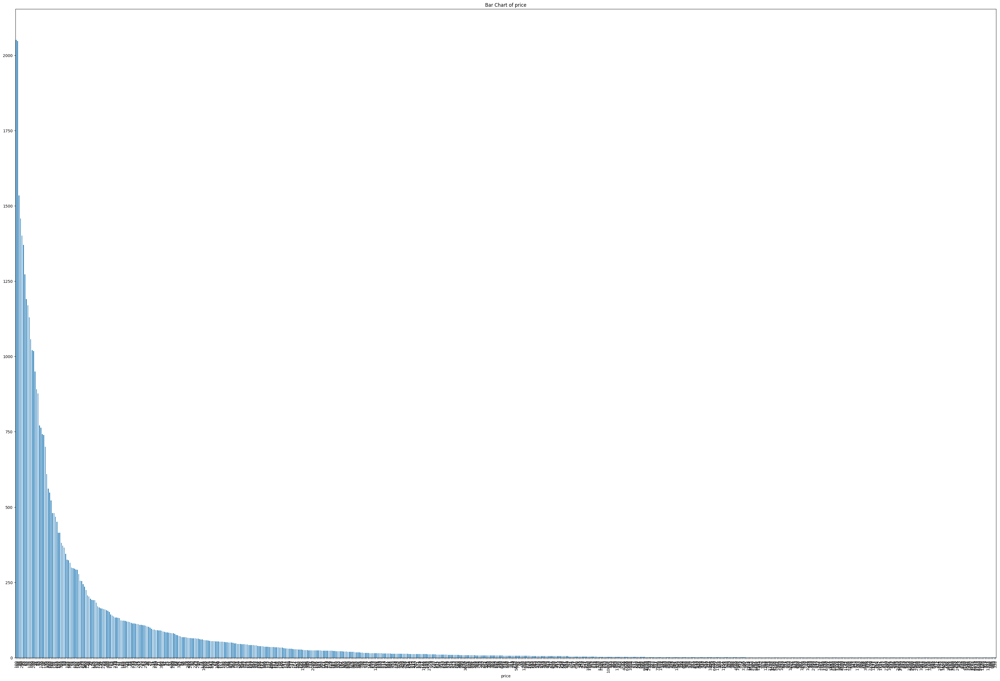

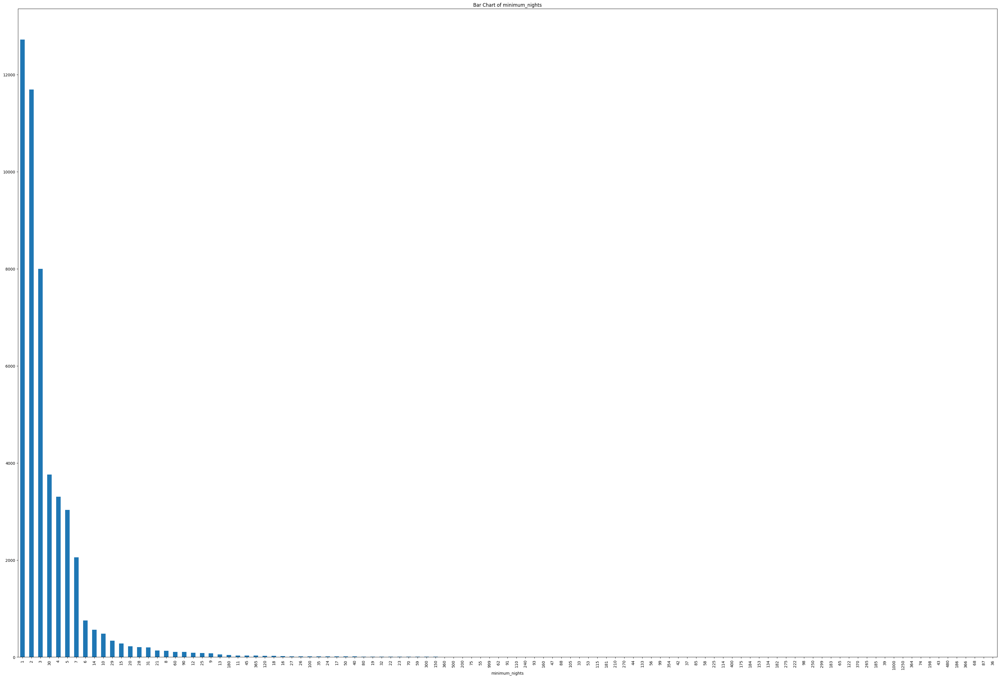

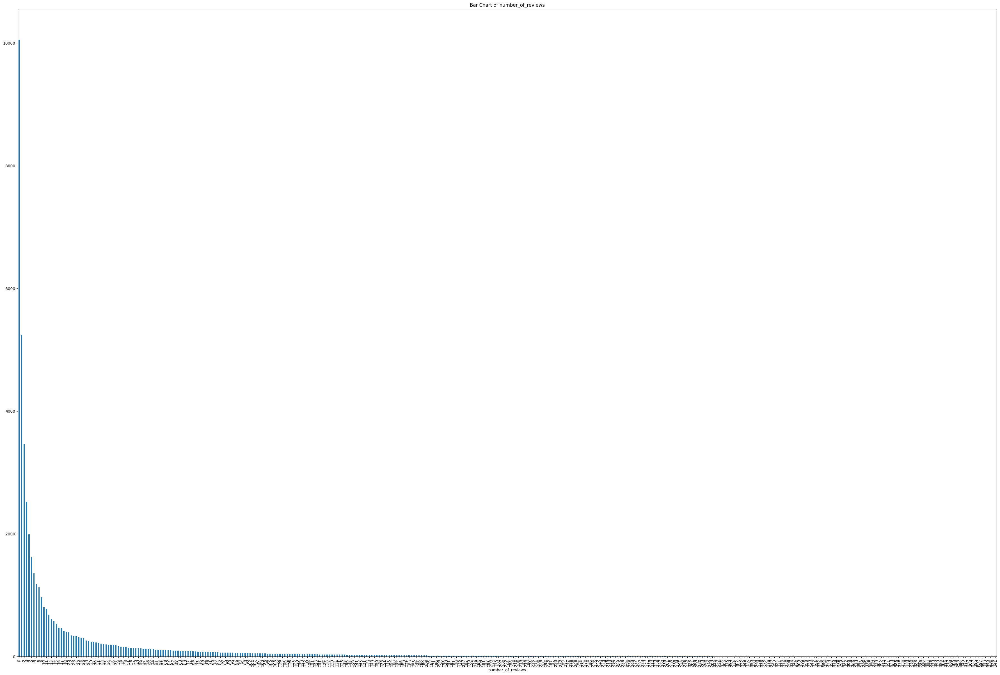

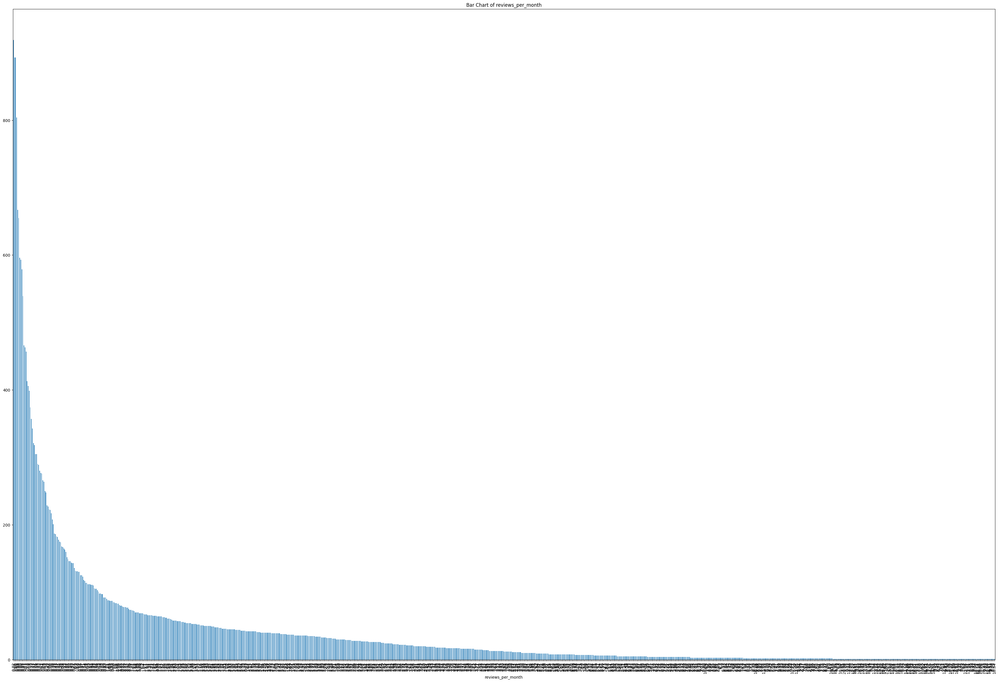

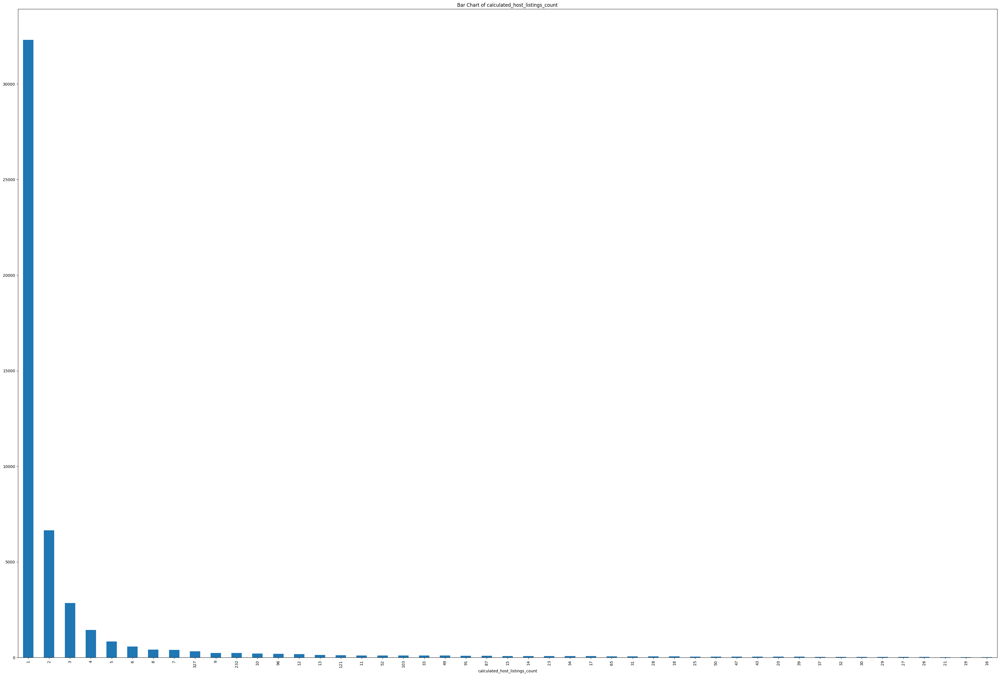

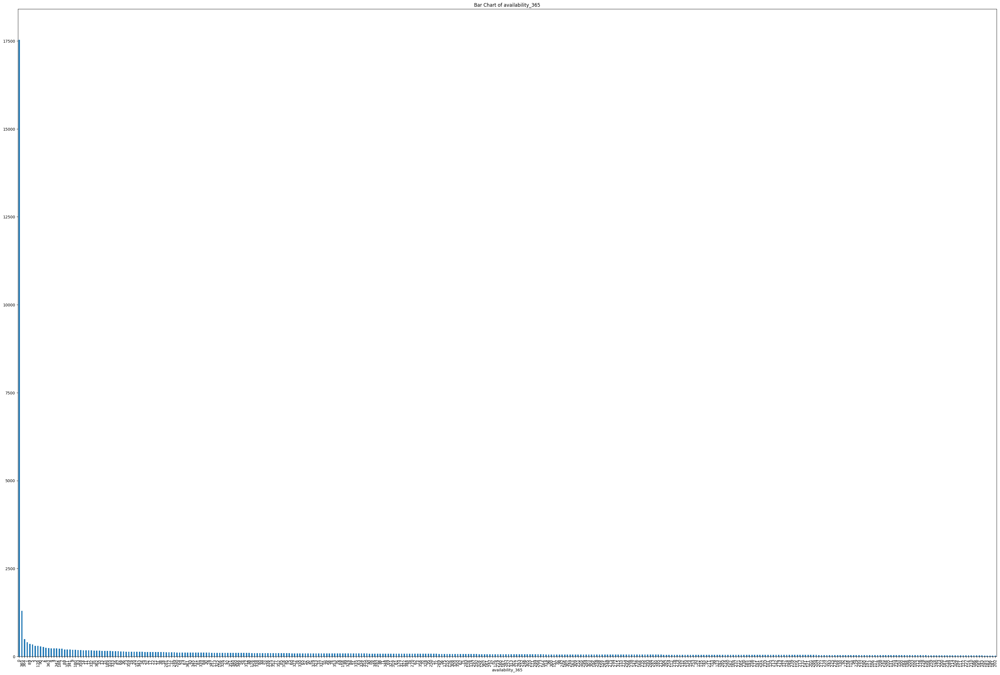

In [ ]:
for col in columns:
    plt.figure(figsize=(45, 30))
    df[col].value_counts().plot(kind='bar')
    plt.title(f'Bar Chart of {col}')

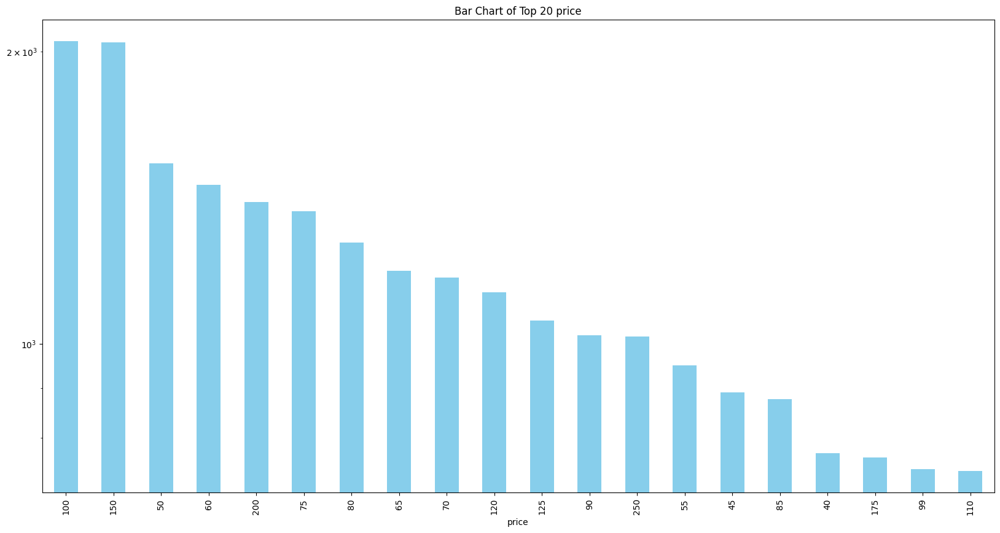

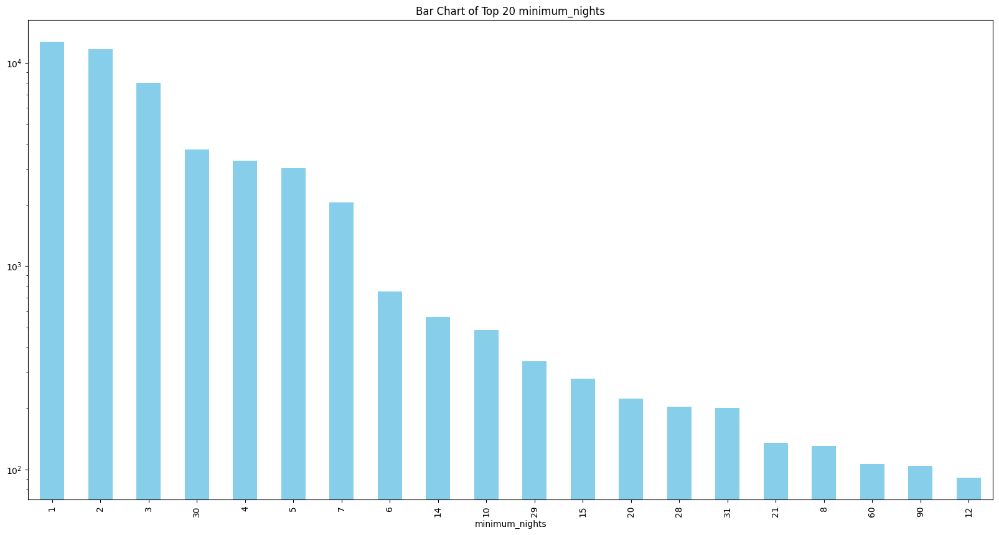

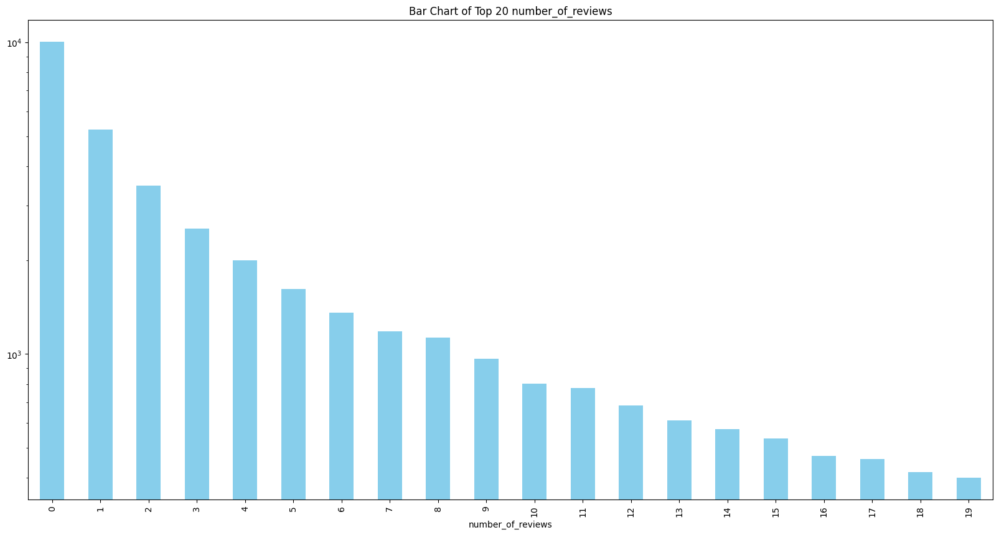

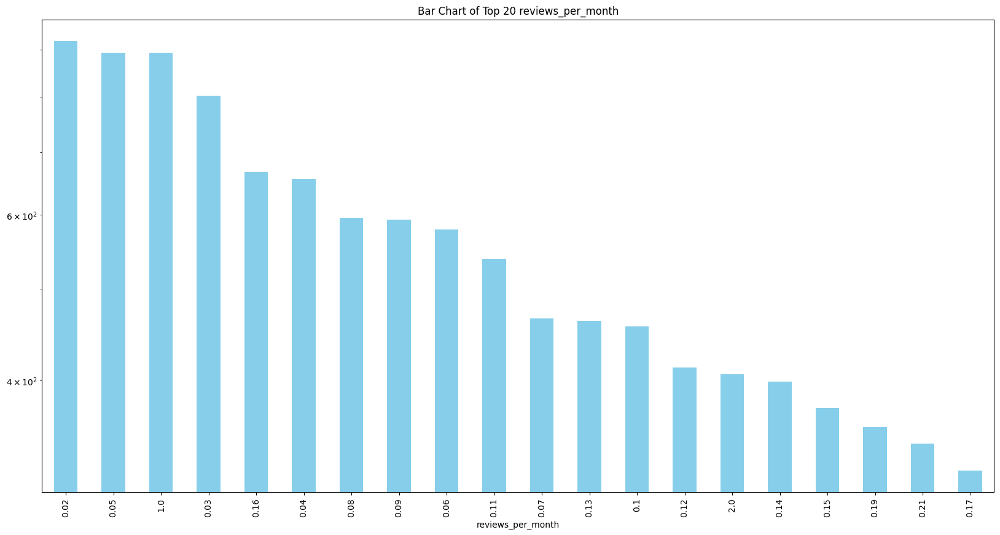

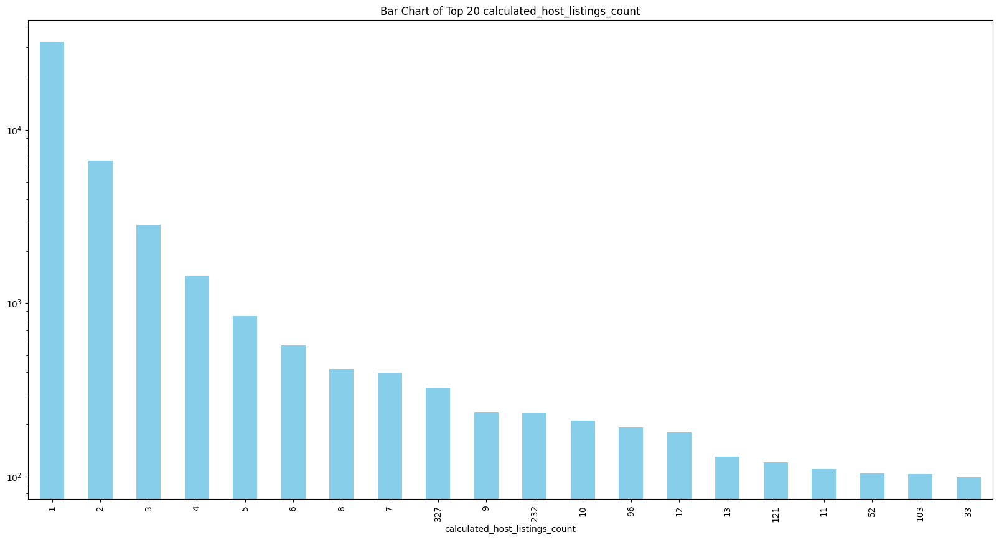

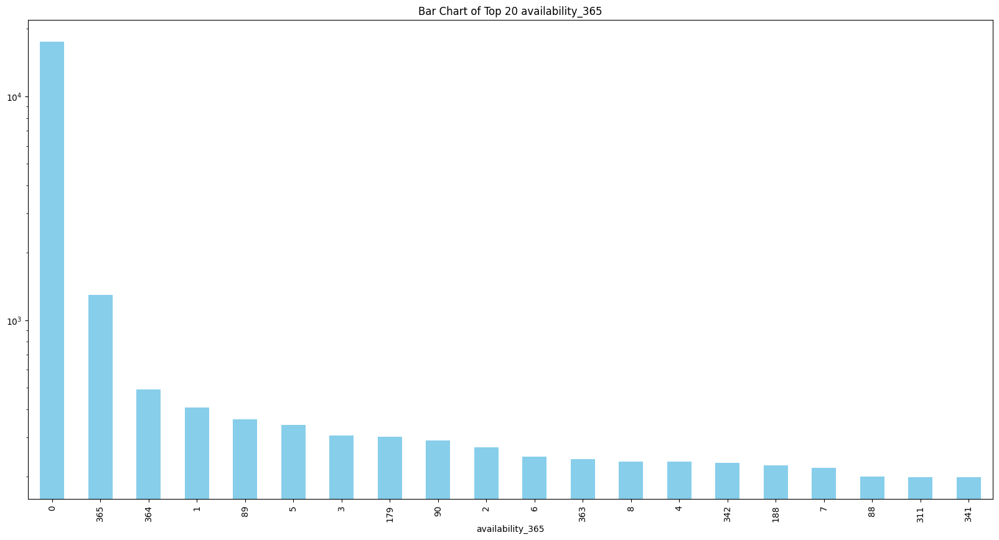

In [ ]:
for col in columns:
    plt.figure(figsize=(20, 10))
    top_values = df[col].value_counts().nlargest(20)  # Display top 20 values
    top_values.plot(kind='bar', color='skyblue')
    plt.title(f'Bar Chart of Top 20 {col}')
    plt.xticks(rotation=90)  # Rotate x-axis labels for better readability
    plt.yscale('log')  # Optional: Apply logarithmic scale to y-axis
    plt.show()


### **Pie Charts**

Price

Text(0.5, 1.0, 'Pie Chart of Price')

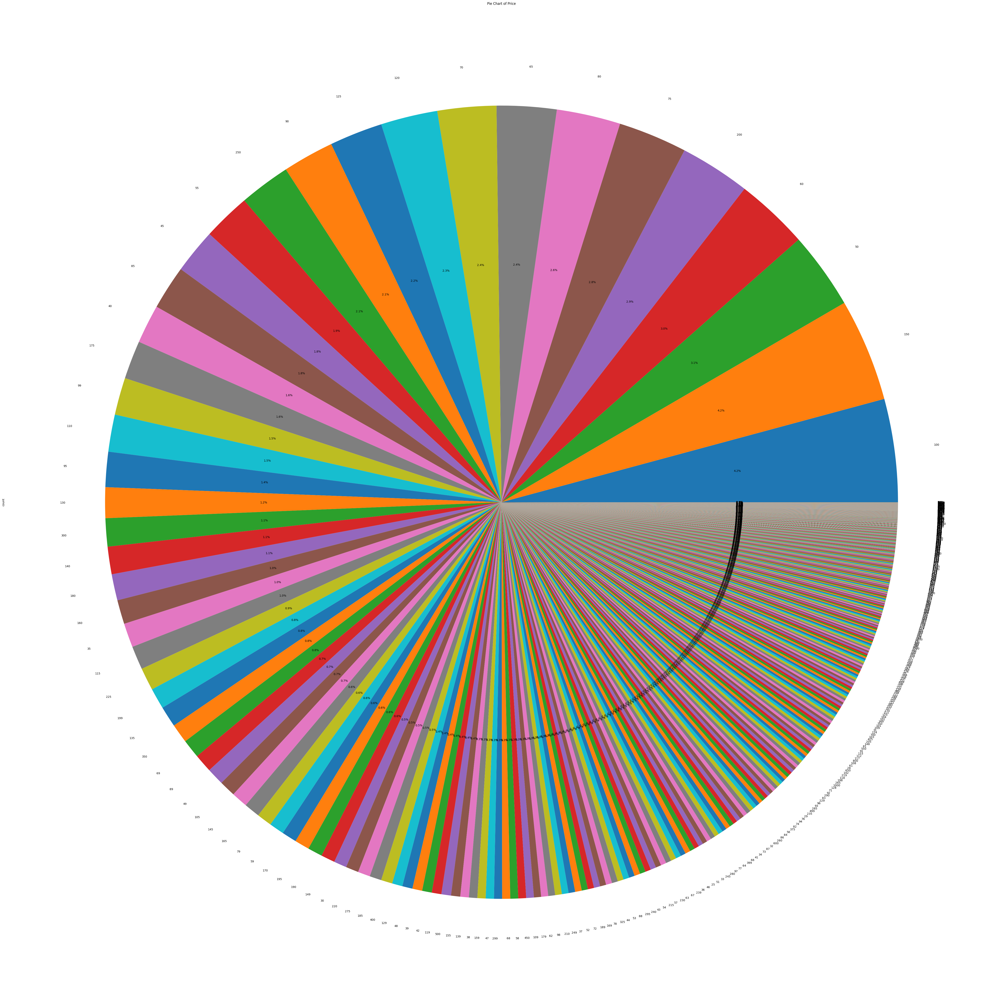

In [ ]:
df['price'].value_counts().plot(kind='pie', autopct='%1.1f%%', figsize=(64, 64))
plt.title('Pie Chart of Price')

minimum_nights

Text(0.5, 1.0, 'Pie Chart of minimum_nights')

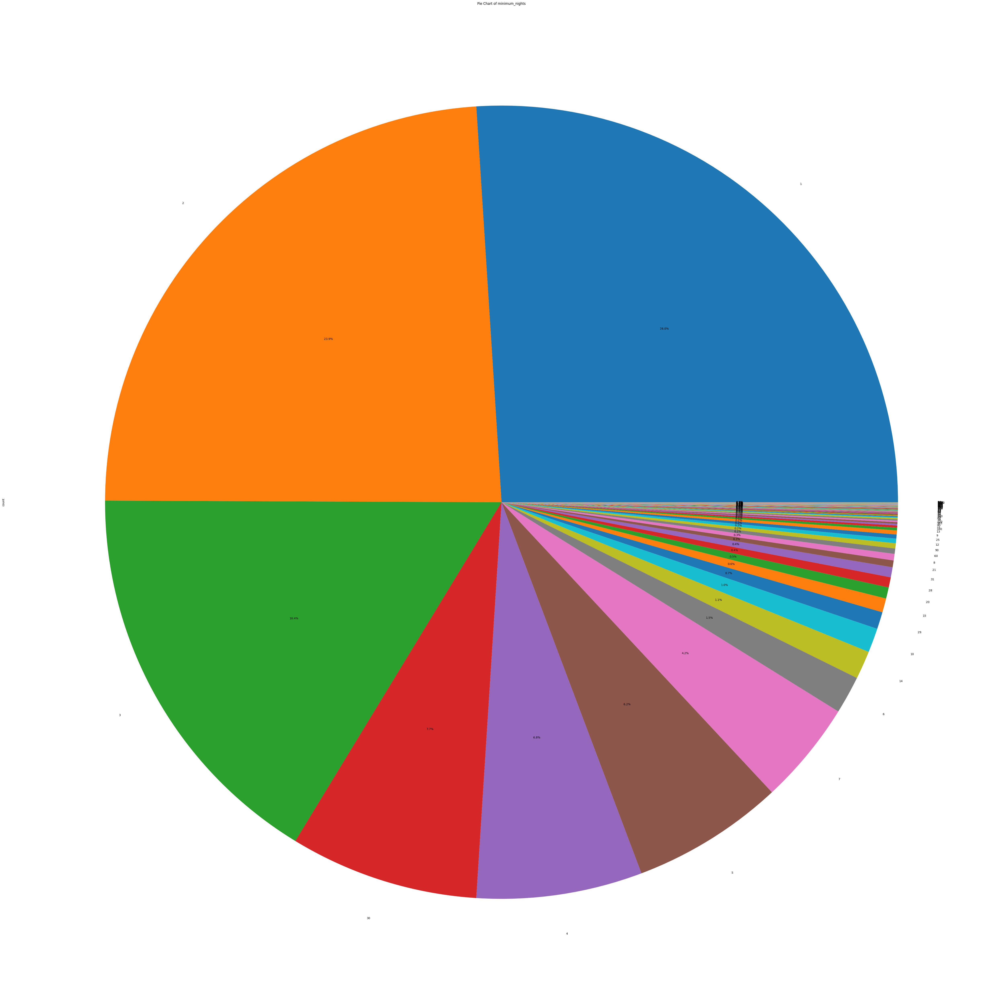

In [ ]:
df['minimum_nights'].value_counts().plot(kind='pie', autopct='%1.1f%%', figsize=(64, 64))
plt.title('Pie Chart of minimum_nights')

number_of_reviews

Text(0.5, 1.0, 'Pie Chart of number_of_reviewss')

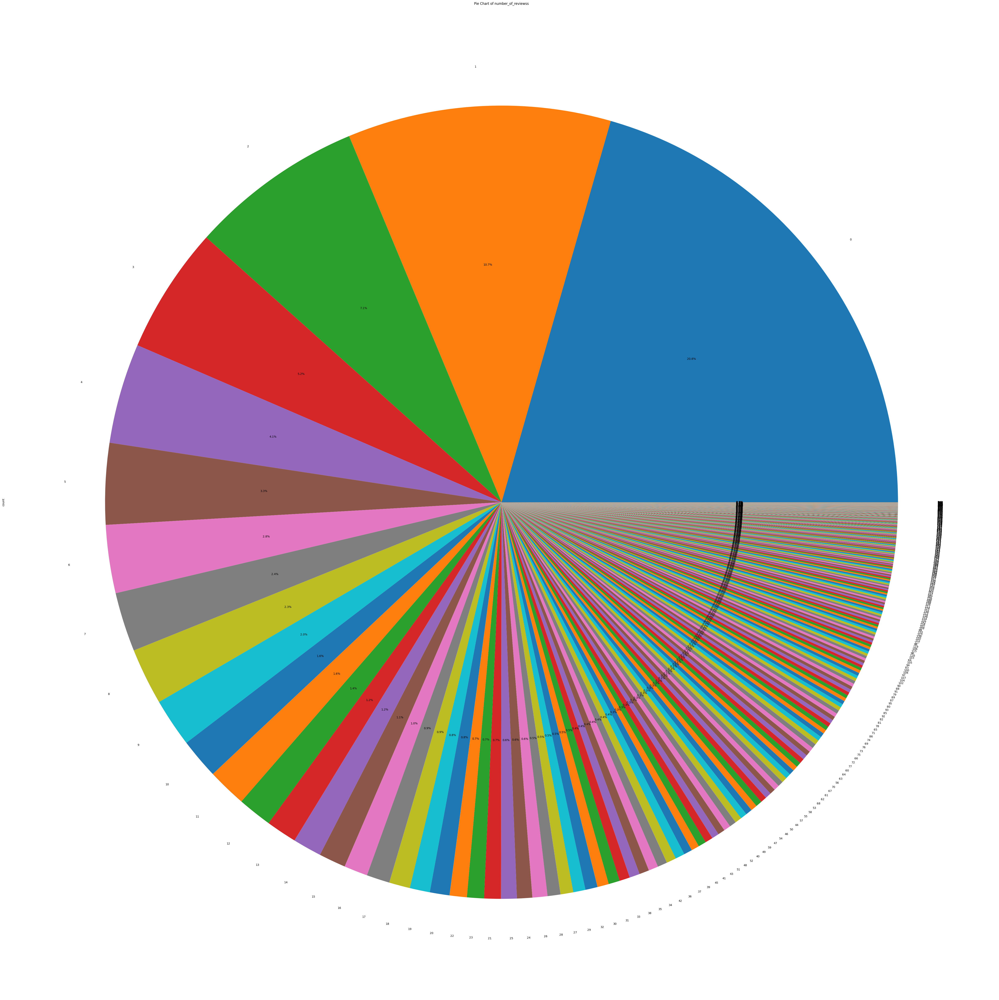

In [ ]:
df['number_of_reviews'].value_counts().plot(kind='pie', autopct='%1.1f%%', figsize=(64, 64))
plt.title('Pie Chart of number_of_reviewss')

reviews_per_month

Text(0.5, 1.0, 'Pie Chart of reviews_per_month')

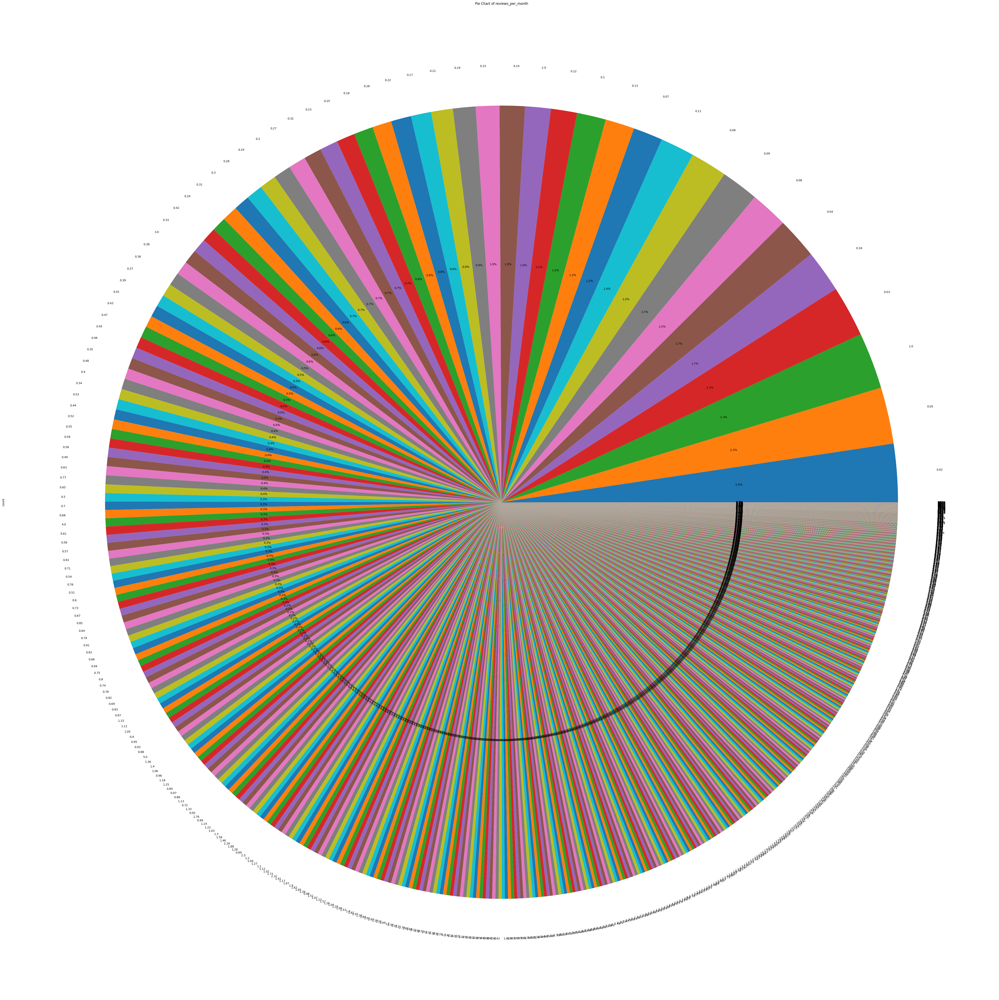

In [ ]:
df['reviews_per_month'].value_counts().plot(kind='pie', autopct='%1.1f%%', figsize=(64, 64))
plt.title('Pie Chart of reviews_per_month')

calculated_host_listings_count

Text(0.5, 1.0, 'Pie Chart of calculated_host_listings_count')

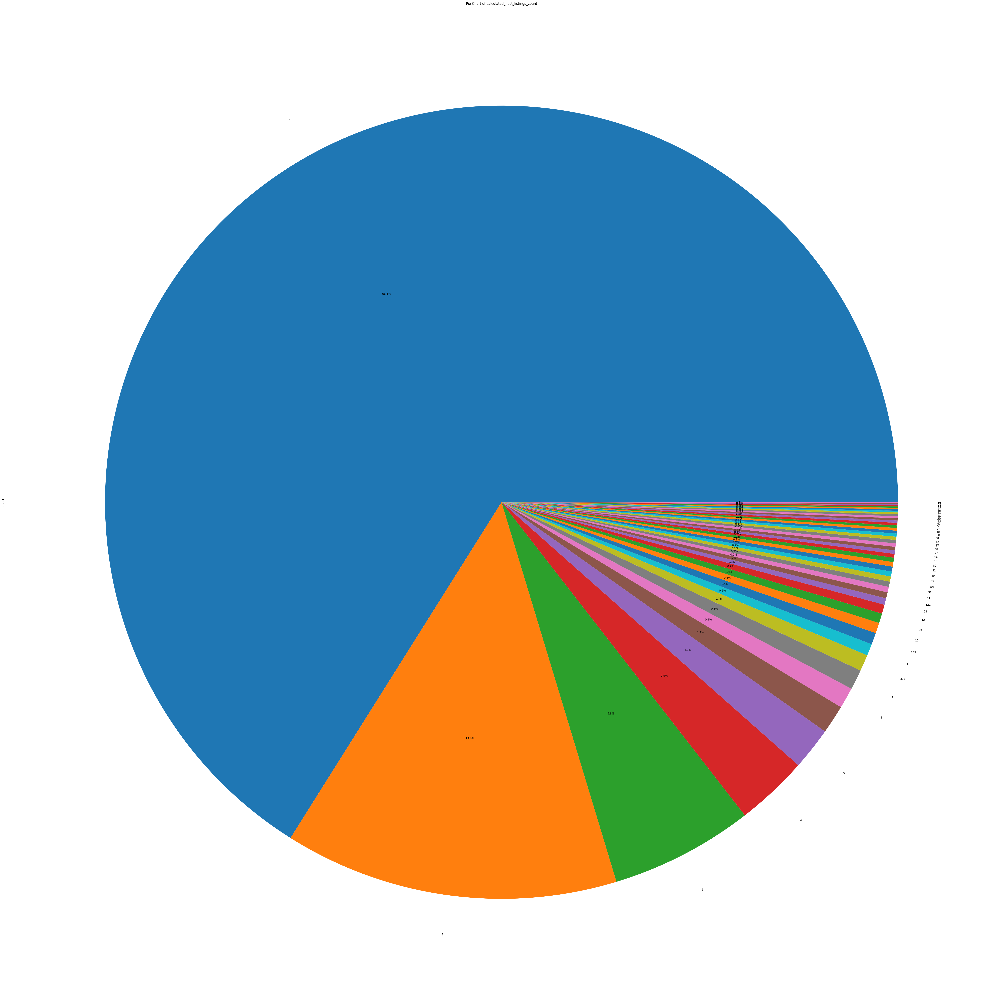

In [ ]:
df['calculated_host_listings_count'].value_counts().plot(kind='pie', autopct='%1.1f%%', figsize=(64, 64))
plt.title('Pie Chart of calculated_host_listings_count')

availability_365

Text(0.5, 1.0, 'Pie Chart of availability_365')

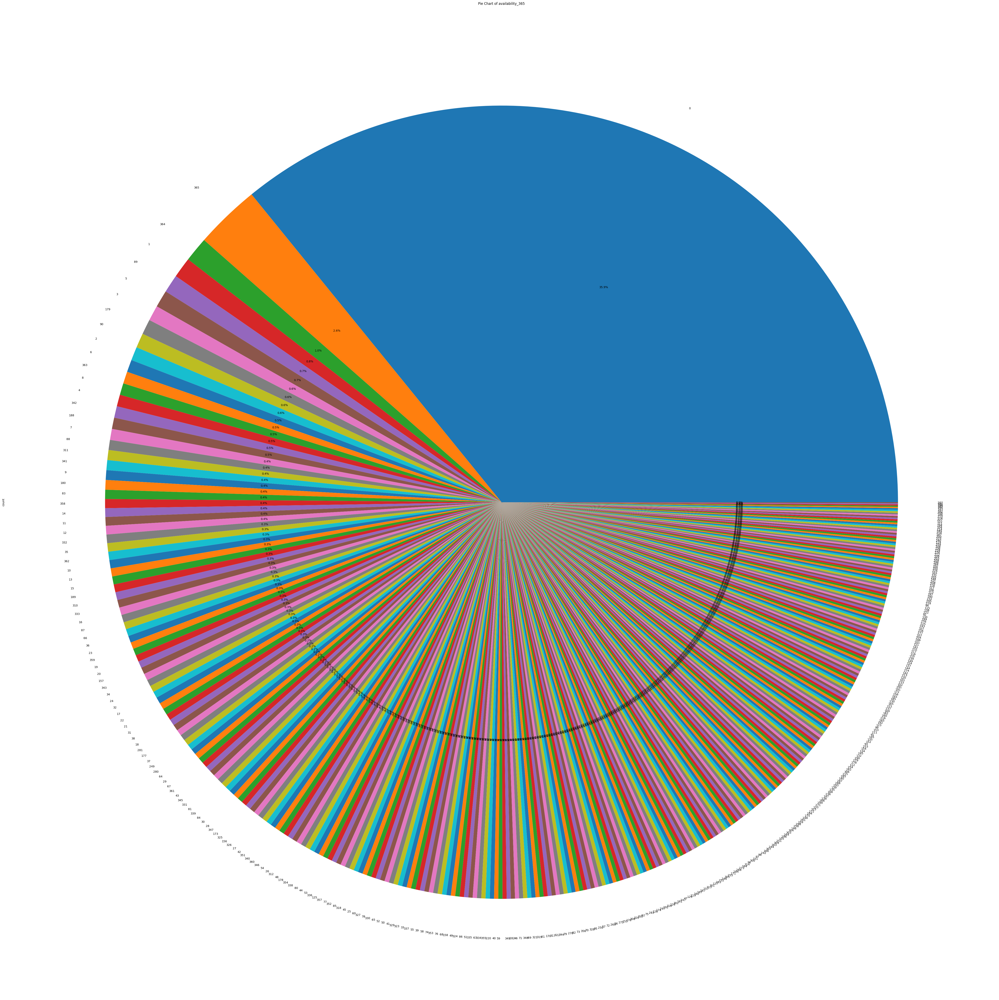

In [ ]:
df['availability_365'].value_counts().plot(kind='pie', autopct='%1.1f%%', figsize=(64, 64))
plt.title('Pie Chart of availability_365')

### **Scatter Plots**

Price v minimum nights

Text(0.5, 1.0, 'Scatter Plot of Price vs Minimum Nights')

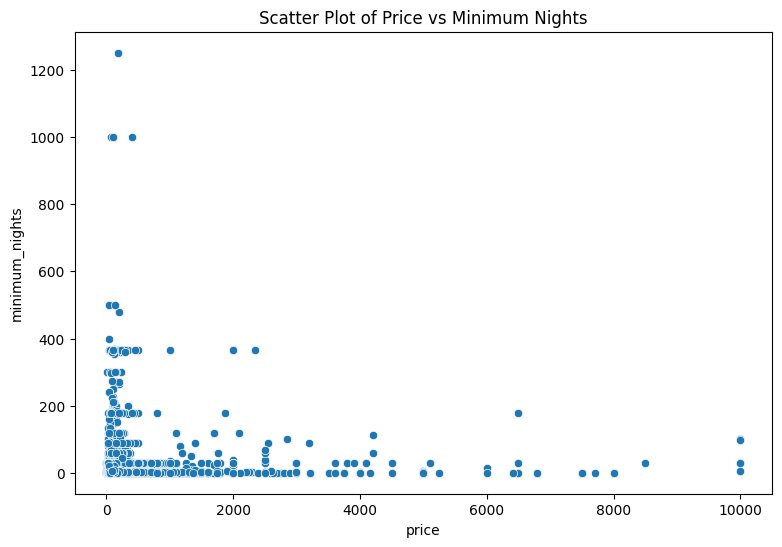

In [ ]:
plt.figure(figsize=(9, 6))
sns.scatterplot(x='price', y='minimum_nights', data=df)
plt.title('Scatter Plot of Price vs Minimum Nights')

price v number of reviews

Text(0.5, 1.0, 'Scatter Plot of Price vs Number of Reviews')

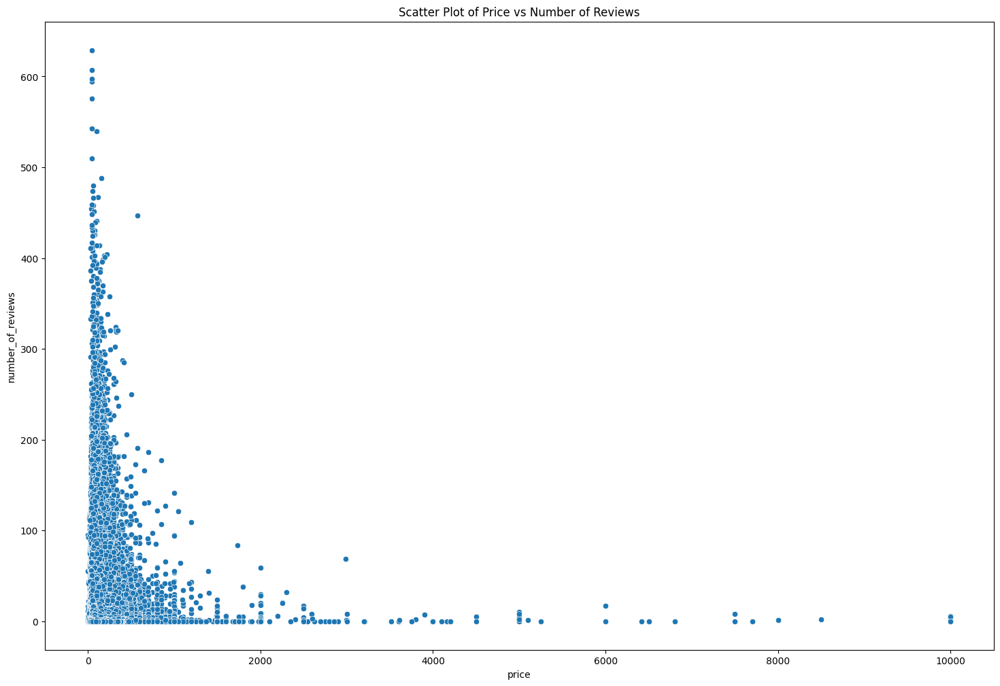

In [ ]:
plt.figure(figsize=(18, 12))
sns.scatterplot(x='price', y='number_of_reviews', data=df)
plt.title('Scatter Plot of Price vs Number of Reviews')

### **Stem-and-Leaf Plots**

In [ ]:
for col in columns:
    stem_data = df[col].dropna().astype(int).values
    stems, leaves = np.divmod(stem_data, 10)
    stem_leaf = pd.DataFrame({'Stem': stems, 'Leaf': leaves})
    print(f'Stem-and-Leaf Plot for {col}')
    print(stem_leaf.groupby('Stem').apply(lambda x: ''.join(x.Leaf.astype(str).values)))

Stem-and-Leaf Plot for price
Stem
0                                             00000000000
1             0866669120005000022950000500100569985312056
2       0995255978075579982899557058498855625789696955...
3       5677699374005995655999865608508555865551585782...
4       4094059226932102885749559659855529550559527054...
                              ...                        
770                                                     3
800                                                     0
850                                                     0
999                                                   999
1000                                                  000
Length: 188, dtype: object
Stem-and-Leaf Plot for minimum_nights
Stem
0      1131322152422213732122143324314211237473733123...
1      0045554444740134445804400540550595444405845045...
2      9996681851708889881870818980010808080010868198...
3      0000010000000000000000500000011000000000000000...
4      55050450505555035505070

## **7. Correlation**

In [ ]:
correlation_matrix = df[columns].corr()
covariance_matrix = df[columns].cov()
print(f"Correlation Matrix:\n{correlation_matrix}\n")
print(f"Covariance Matrix:\n{covariance_matrix}\n")

Correlation Matrix:
                                   price  minimum_nights  number_of_reviews  \
price                           1.000000        0.042799          -0.047954   
minimum_nights                  0.042799        1.000000          -0.080116   
number_of_reviews              -0.047954       -0.080116           1.000000   
reviews_per_month              -0.030608       -0.121702           0.549868   
calculated_host_listings_count  0.057472        0.127960          -0.072376   
availability_365                0.081829        0.144303           0.172028   

                                reviews_per_month  \
price                                   -0.030608   
minimum_nights                          -0.121702   
number_of_reviews                        0.549868   
reviews_per_month                        1.000000   
calculated_host_listings_count          -0.009421   
availability_365                         0.185791   

                                calculated_host_listin

## **8. Data Types and Measurement Levels**

In [ ]:
data_types = df[columns].dtypes
measurement_levels = {col: 'Ratio' for col in columns}

print(f"Data Types:\n{data_types}\n")
print(f"Measurement Levels:\n{measurement_levels}\n")

Data Types:
price                               int64
minimum_nights                      int64
number_of_reviews                   int64
reviews_per_month                 float64
calculated_host_listings_count      int64
availability_365                    int64
dtype: object

Measurement Levels:
{'price': 'Ratio', 'minimum_nights': 'Ratio', 'number_of_reviews': 'Ratio', 'reviews_per_month': 'Ratio', 'calculated_host_listings_count': 'Ratio', 'availability_365': 'Ratio'}



## **9. Outliers Detection**

In [ ]:
outliers = {}
for col in columns:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outliers[col] = df[(df[col] < lower_bound) | (df[col] > upper_bound)]

for col in outliers:
    print(f"\nOutliers in {col}:\n{outliers[col]}\n")


Outliers in price:
             id                                               name    host_id  \
61        15396                 Sunny & Spacious Chelsea Apartment      60278   
85        19601                perfect for a family or small group      74303   
103       23686  2000 SF 3br 2bath West Village private  townhouse      93790   
114       26933  2 BR / 2 Bath Duplex Apt with patio! East Village      72062   
121       27659                   3 Story Town House in Park Slope     119588   
...         ...                                                ...        ...   
48758  36420289    Rustic Garden House Apt, 2 stops from Manhattan   73211393   
48833  36450896   Brand New 3-Bed Apt in the Best Location of FiDi   29741813   
48839  36452721  Massage Spa. Stay overnight. Authors Artist dr...  274079964   
48842  36453160  LUXURY MANHATTAN PENTHOUSE+HUDSON RIVER+EMPIRE...  224171371   
48856  36457700  Large 3 bed, 2 bath , garden , bbq , all you need   66993395   

       

Z-score method

In [ ]:
from scipy import stats

# Z-Score Method
zscore_outliers = {}
threshold = 3  # You can change this threshold if needed

for col in columns:
    # Calculate Z-scores for the column after dropping NaN values
    z_scores = stats.zscore(df[col].dropna())

    # Create a boolean series for outliers
    outlier_mask = (z_scores > threshold) | (z_scores < -threshold)

    # Reindex the mask to match the original dataframe's index
    outlier_mask = outlier_mask.reindex(df.index, fill_value=False)

    # Filter out the outliers based on the mask
    zscore_outliers[col] = df[outlier_mask]

for col in zscore_outliers:
    print(f"\nZ-Score Outliers in {col}:\n{zscore_outliers[col]}\n")



Z-Score Outliers in price:
             id                                               name    host_id  \
496      174966              Luxury 2Bed/2.5Bath Central Park View     836168   
762      273190          6 Bedroom Landmark West Village Townhouse     605463   
946      363673                   Beautiful 3 bedroom in Manhattan     256239   
1105     468613   $ (Phone number hidden by Airbnb) weeks - room f    2325861   
1414     634353                Luxury 1Bed with Central Park Views     836168   
...         ...                                                ...        ...   
48301  36186719           Private Bedroom in the Heart of Chelsea!  268920555   
48304  36189195      Next to Times Square/Javits/MSG! Amazing 1BR!  270214015   
48305  36189257             2BR Near Museum Mile! Upper East Side!  272166348   
48523  36308562  Tasteful & Trendy Brooklyn Brownstone, near Train  217732163   
48535  36311055     Stunning & Stylish Brooklyn Luxury, near Train  245712163   


IQR

In [ ]:
# IQR Method
iqr_outliers = {}

for col in columns:
    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    iqr_outliers[col] = df[(df[col] < lower_bound) | (df[col] > upper_bound)]

for col in iqr_outliers:
    print(f"\nIQR Outliers in {col}:\n{iqr_outliers[col]}\n")



IQR Outliers in price:
             id                                               name    host_id  \
61        15396                 Sunny & Spacious Chelsea Apartment      60278   
85        19601                perfect for a family or small group      74303   
103       23686  2000 SF 3br 2bath West Village private  townhouse      93790   
114       26933  2 BR / 2 Bath Duplex Apt with patio! East Village      72062   
121       27659                   3 Story Town House in Park Slope     119588   
...         ...                                                ...        ...   
48758  36420289    Rustic Garden House Apt, 2 stops from Manhattan   73211393   
48833  36450896   Brand New 3-Bed Apt in the Best Location of FiDi   29741813   
48839  36452721  Massage Spa. Stay overnight. Authors Artist dr...  274079964   
48842  36453160  LUXURY MANHATTAN PENTHOUSE+HUDSON RIVER+EMPIRE...  224171371   
48856  36457700  Large 3 bed, 2 bath , garden , bbq , all you need   66993395   

   

Box-plot method

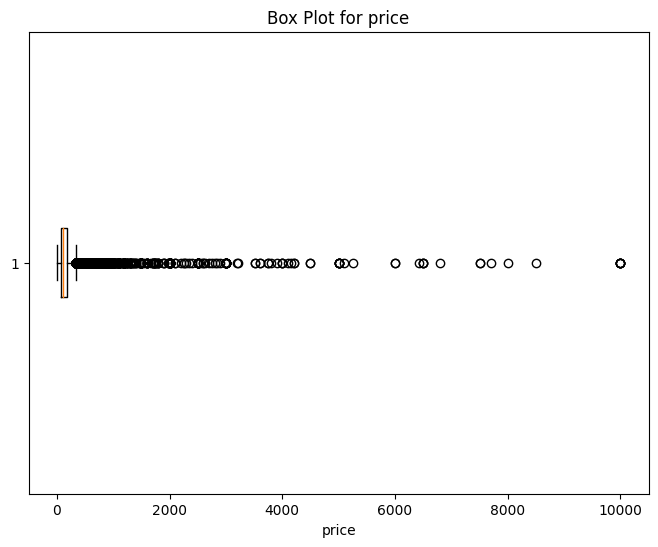

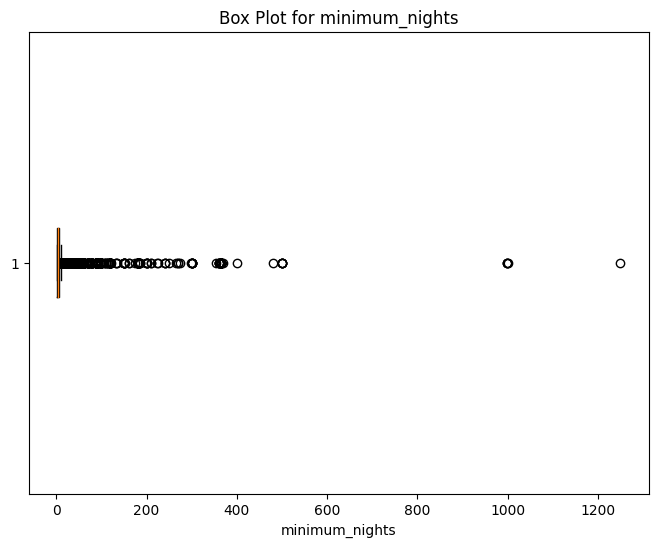

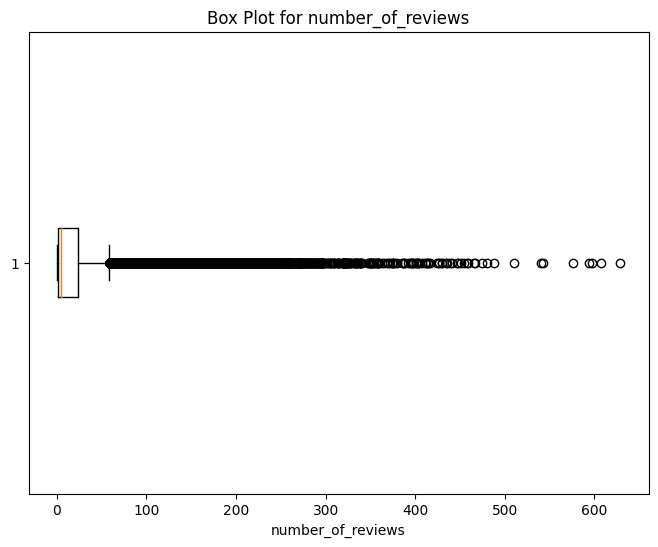

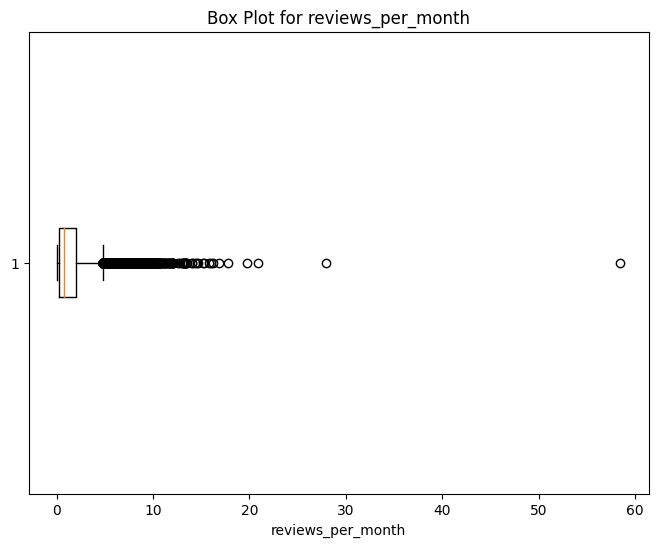

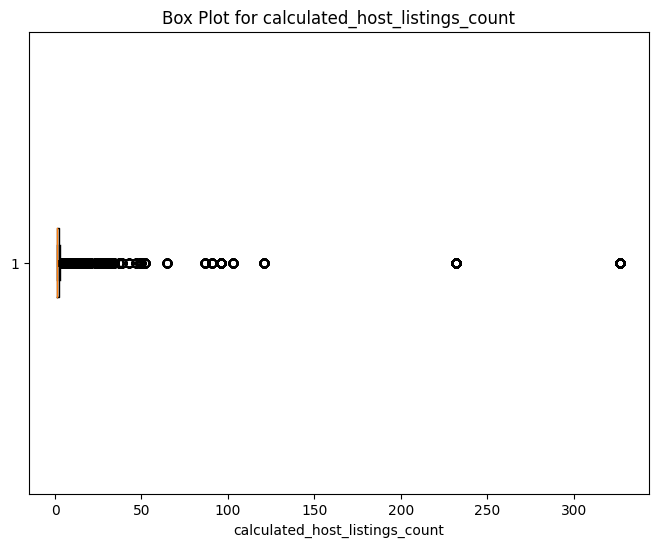

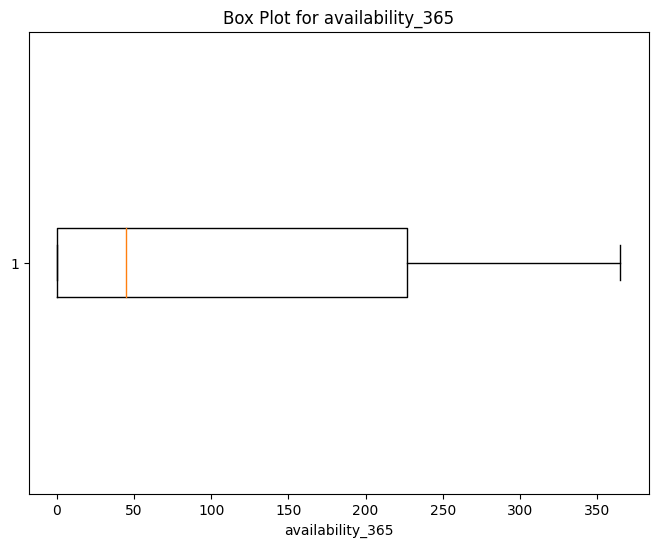


Box Plot Outliers in price:
             id                                               name    host_id  \
61        15396                 Sunny & Spacious Chelsea Apartment      60278   
85        19601                perfect for a family or small group      74303   
103       23686  2000 SF 3br 2bath West Village private  townhouse      93790   
114       26933  2 BR / 2 Bath Duplex Apt with patio! East Village      72062   
121       27659                   3 Story Town House in Park Slope     119588   
...         ...                                                ...        ...   
48758  36420289    Rustic Garden House Apt, 2 stops from Manhattan   73211393   
48833  36450896   Brand New 3-Bed Apt in the Best Location of FiDi   29741813   
48839  36452721  Massage Spa. Stay overnight. Authors Artist dr...  274079964   
48842  36453160  LUXURY MANHATTAN PENTHOUSE+HUDSON RIVER+EMPIRE...  224171371   
48856  36457700  Large 3 bed, 2 bath , garden , bbq , all you need   66993395   

In [ ]:
import matplotlib.pyplot as plt

# Box Plot Method
boxplot_outliers = {}

for col in columns:
    plt.figure(figsize=(8, 6))
    plt.boxplot(df[col].dropna(), vert=False)
    plt.title(f'Box Plot for {col}')
    plt.xlabel(col)
    plt.show()

    Q1 = df[col].quantile(0.25)
    Q3 = df[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    boxplot_outliers[col] = df[(df[col] < lower_bound) | (df[col] > upper_bound)]

for col in boxplot_outliers:
    print(f"\nBox Plot Outliers in {col}:\n{boxplot_outliers[col]}\n")


## **10. Summary Statistics**

In [ ]:
five_num_summary = df[columns].describe().loc[['min', '25%', '50%', '75%', 'max']]
desc_stats_summary = df[columns].describe()

print(f"Five-Number Summary:\n{five_num_summary}\n")
print(f"Descriptive Statistics Summary:\n{desc_stats_summary}\n")

Five-Number Summary:
       price  minimum_nights  number_of_reviews  reviews_per_month  \
min      0.0             1.0                0.0               0.01   
25%     69.0             1.0                1.0               0.19   
50%    106.0             3.0                5.0               0.72   
75%    175.0             5.0               24.0               2.02   
max  10000.0          1250.0              629.0              58.50   

     calculated_host_listings_count  availability_365  
min                             1.0               0.0  
25%                             1.0               0.0  
50%                             1.0              45.0  
75%                             2.0             227.0  
max                           327.0             365.0  

Descriptive Statistics Summary:
              price  minimum_nights  number_of_reviews  reviews_per_month  \
count  48895.000000    48895.000000       48895.000000       38843.000000   
mean     152.720687        7.029962

## **Ex: Catgorical columns**

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')
df=pd.read_csv('gdrive/My Drive/colab_datasets/AB_NYC_2019.csv')
df

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


,id,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
0,2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
1,2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
2,3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3,3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
4,5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48890,36484665,Charming one bedroom - newly renovated rowhouse,8232441,Sabrina,Brooklyn,Bedford-Stuyvesant,40.67853,-73.94995,Private room,70,2,0,NaN,NaN,2,9
48891,36485057,Affordable room in Bushwick/East Williamsburg,6570630,Marisol,Brooklyn,Bushwick,40.70184,-73.93317,Private room,40,4,0,NaN,NaN,2,36
48892,36485431,Sunny Studio at Historical Neighborhood,23492952,Ilgar & Aysel,Manhattan,Harlem,40.81475,-73.94867,Entire home/apt,115,10,0,NaN,NaN,1,27
48893,36485609,43rd St. Time Square-cozy single bed,30985759,Taz,Manhattan,Hell's Kitchen,40.75751,-73.99112,Shared room,55,1,0,NaN,NaN,6,2


In [ ]:
#columns to go for neighbourhood_group, neighbourhood, room_type, host_id, host_name
df.columns

Index(['id', 'name', 'host_id', 'host_name', 'neighbourhood_group',
       'neighbourhood', 'latitude', 'longitude', 'room_type', 'price',
       'minimum_nights', 'number_of_reviews', 'last_review',
       'reviews_per_month', 'calculated_host_listings_count',
       'availability_365'],
      dtype='object')

In [ ]:
columns2 = ['neighbourhood_group', 'neighbourhood', 'room_type', 'host_id', 'host_name']

### **Frequency Distribution**

In [ ]:
for column in columns2:
  freq_tab=df[column].value_counts() #rel freq
  print(freq_tab)
  print(" \n")

neighbourhood_group
Manhattan        21661
Brooklyn         20104
Queens            5666
Bronx             1091
Staten Island      373
Name: count, dtype: int64
 

neighbourhood
Williamsburg          3920
Bedford-Stuyvesant    3714
Harlem                2658
Bushwick              2465
Upper West Side       1971
                      ... 
Fort Wadsworth           1
Richmondtown             1
New Dorp                 1
Rossville                1
Willowbrook              1
Name: count, Length: 221, dtype: int64
 

room_type
Entire home/apt    25409
Private room       22326
Shared room         1160
Name: count, dtype: int64
 

host_id
219517861    327
107434423    232
30283594     121
137358866    103
16098958      96
            ... 
23727216       1
89211125       1
19928013       1
1017772        1
68119814       1
Name: count, Length: 37457, dtype: int64
 

host_name
Michael              417
David                403
Sonder (NYC)         327
John                 294
Alex                

In [ ]:
for column in columns2:
  freq_tab=df[column].value_counts(normalize=True) #rel freq
  print(freq_tab)
  print(" \n")

neighbourhood_group
Manhattan        0.443011
Brooklyn         0.411167
Queens           0.115881
Bronx            0.022313
Staten Island    0.007629
Name: proportion, dtype: float64
 

neighbourhood
Williamsburg          0.080172
Bedford-Stuyvesant    0.075959
Harlem                0.054361
Bushwick              0.050414
Upper West Side       0.040311
                        ...   
Fort Wadsworth        0.000020
Richmondtown          0.000020
New Dorp              0.000020
Rossville             0.000020
Willowbrook           0.000020
Name: proportion, Length: 221, dtype: float64
 

room_type
Entire home/apt    0.519665
Private room       0.456611
Shared room        0.023724
Name: proportion, dtype: float64
 

host_id
219517861    0.006688
107434423    0.004745
30283594     0.002475
137358866    0.002107
16098958     0.001963
               ...   
23727216     0.000020
89211125     0.000020
19928013     0.000020
1017772      0.000020
68119814     0.000020
Name: proportion, Length: 3745

In [ ]:
for column in columns2:
  freq_tab=df[column].value_counts().cumsum() #cumulative freq
  print(freq_tab)
  print(" \n")

neighbourhood_group
Manhattan        21661
Brooklyn         41765
Queens           47431
Bronx            48522
Staten Island    48895
Name: count, dtype: int64
 

neighbourhood
Williamsburg           3920
Bedford-Stuyvesant     7634
Harlem                10292
Bushwick              12757
Upper West Side       14728
                      ...  
Fort Wadsworth        48891
Richmondtown          48892
New Dorp              48893
Rossville             48894
Willowbrook           48895
Name: count, Length: 221, dtype: int64
 

room_type
Entire home/apt    25409
Private room       47735
Shared room        48895
Name: count, dtype: int64
 

host_id
219517861      327
107434423      559
30283594       680
137358866      783
16098958       879
             ...  
23727216     48891
89211125     48892
19928013     48893
1017772      48894
68119814     48895
Name: count, Length: 37457, dtype: int64
 

host_name
Michael                417
David                  820
Sonder (NYC)          1147
John  

take each instance as one

In [ ]:
freq_tables2 = df[columns2].value_counts().reset_index(name='count')
freq_tables2

,neighbourhood_group,neighbourhood,room_type,host_id,host_name,count
0,Manhattan,Financial District,Entire home/apt,219517861,Sonder (NYC),210
1,Brooklyn,Greenpoint,Entire home/apt,7503643,Vida,52
2,Manhattan,Financial District,Entire home/apt,12243051,Sonder,51
3,Manhattan,Murray Hill,Entire home/apt,219517861,Sonder (NYC),50
4,Manhattan,Murray Hill,Entire home/apt,120762452,Stanley,49
...,...,...,...,...,...,...
39680,Brooklyn,Williamsburg,Entire home/apt,1334808,Kristina,1
39681,Brooklyn,Williamsburg,Entire home/apt,1335392,Matthew,1
39682,Brooklyn,Williamsburg,Entire home/apt,1363910,Emily,1
39683,Brooklyn,Williamsburg,Entire home/apt,1366194,Fabiana,1


In [ ]:
rel_freq2 = df[columns2].value_counts(normalize=True).reset_index(name='relative_freq')
rel_freq2

,neighbourhood_group,neighbourhood,room_type,host_id,host_name,relative_freq
0,Manhattan,Financial District,Entire home/apt,219517861,Sonder (NYC),0.004297
1,Brooklyn,Greenpoint,Entire home/apt,7503643,Vida,0.001064
2,Manhattan,Financial District,Entire home/apt,12243051,Sonder,0.001043
3,Manhattan,Murray Hill,Entire home/apt,219517861,Sonder (NYC),0.001023
4,Manhattan,Murray Hill,Entire home/apt,120762452,Stanley,0.001003
...,...,...,...,...,...,...
39680,Brooklyn,Williamsburg,Entire home/apt,1334808,Kristina,0.000020
39681,Brooklyn,Williamsburg,Entire home/apt,1335392,Matthew,0.000020
39682,Brooklyn,Williamsburg,Entire home/apt,1363910,Emily,0.000020
39683,Brooklyn,Williamsburg,Entire home/apt,1366194,Fabiana,0.000020


In [ ]:
cumulative_freq2 = df[columns2].value_counts(normalize=True).cumsum().reset_index(name='cumulative_freq')
cumulative_freq2

,neighbourhood_group,neighbourhood,room_type,host_id,host_name,cumulative_freq
0,Manhattan,Financial District,Entire home/apt,219517861,Sonder (NYC),0.004297
1,Brooklyn,Greenpoint,Entire home/apt,7503643,Vida,0.005361
2,Manhattan,Financial District,Entire home/apt,12243051,Sonder,0.006404
3,Manhattan,Murray Hill,Entire home/apt,219517861,Sonder (NYC),0.007427
4,Manhattan,Murray Hill,Entire home/apt,120762452,Stanley,0.008430
...,...,...,...,...,...,...
39680,Brooklyn,Williamsburg,Entire home/apt,1334808,Kristina,0.999918
39681,Brooklyn,Williamsburg,Entire home/apt,1335392,Matthew,0.999939
39682,Brooklyn,Williamsburg,Entire home/apt,1363910,Emily,0.999959
39683,Brooklyn,Williamsburg,Entire home/apt,1366194,Fabiana,0.999980


### **Mode**

In [ ]:
mode2 = df[columns2].mode().iloc[0]
mode2

,0
neighbourhood_group,Manhattan
neighbourhood,Williamsburg
room_type,Entire home/apt
host_id,219517861
host_name,Michael


### **Data Visualisation**

Bar Chart

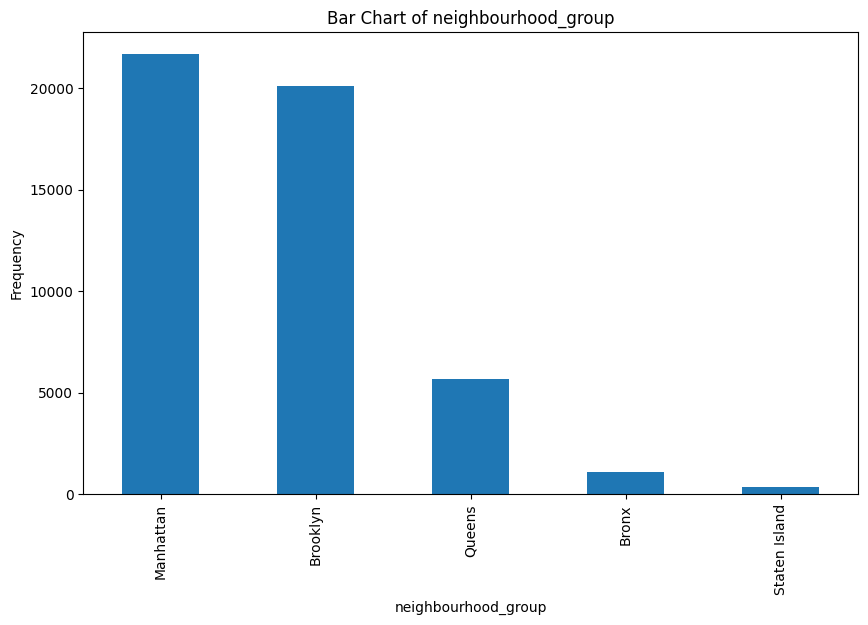

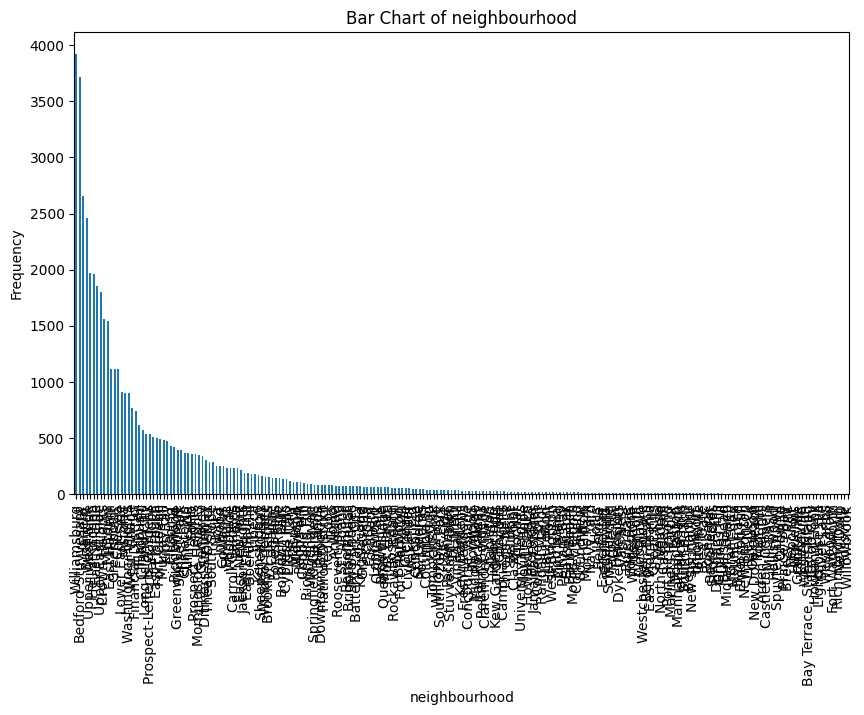

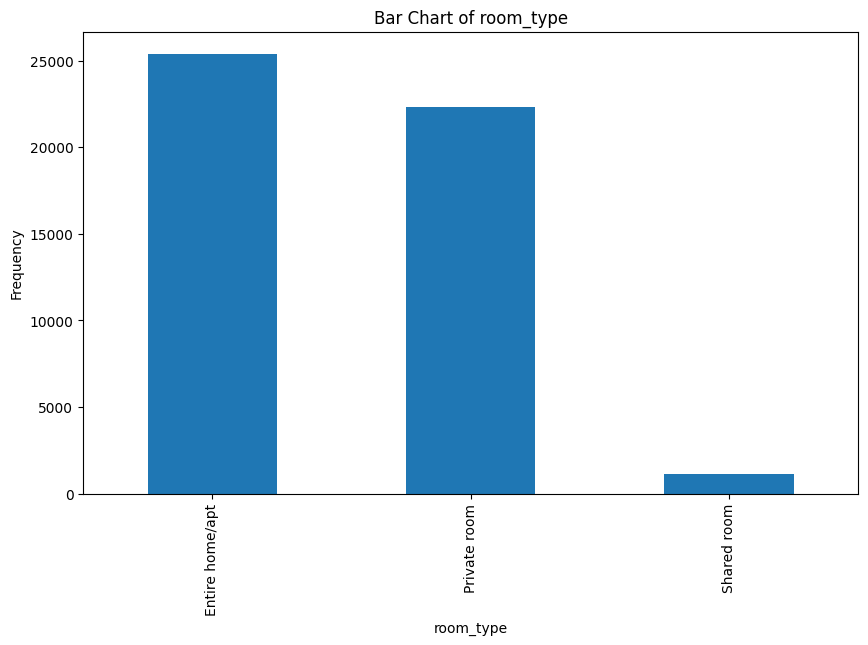

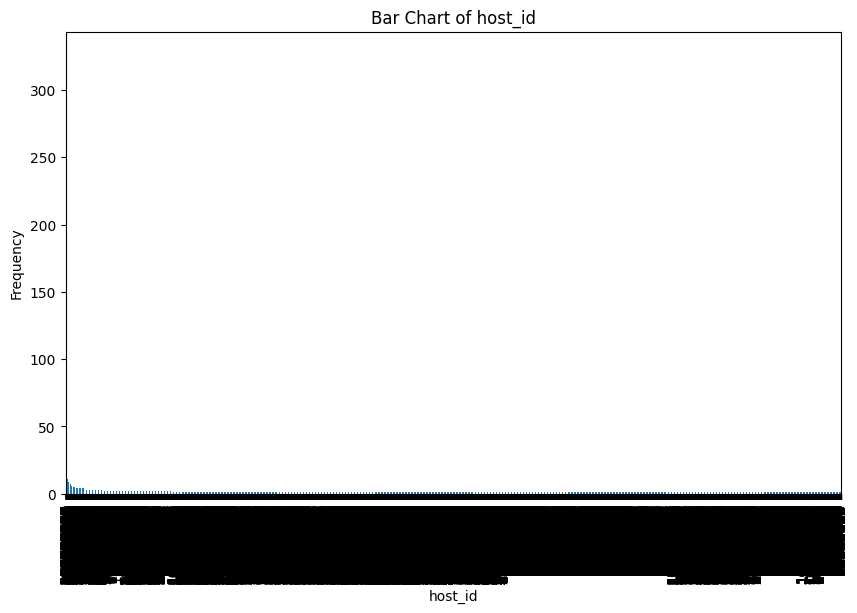

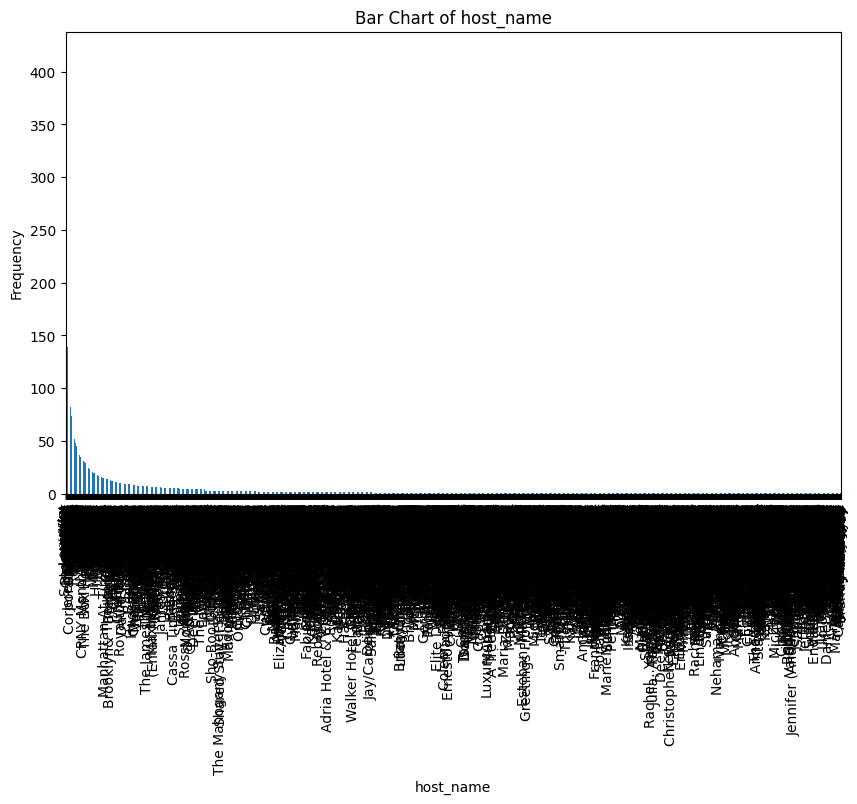

In [ ]:
for column in columns2:
    plt.figure(figsize=(10, 6))
    df[column].value_counts().plot(kind='bar')
    plt.title(f'Bar Chart of {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.show()


Pie Chart

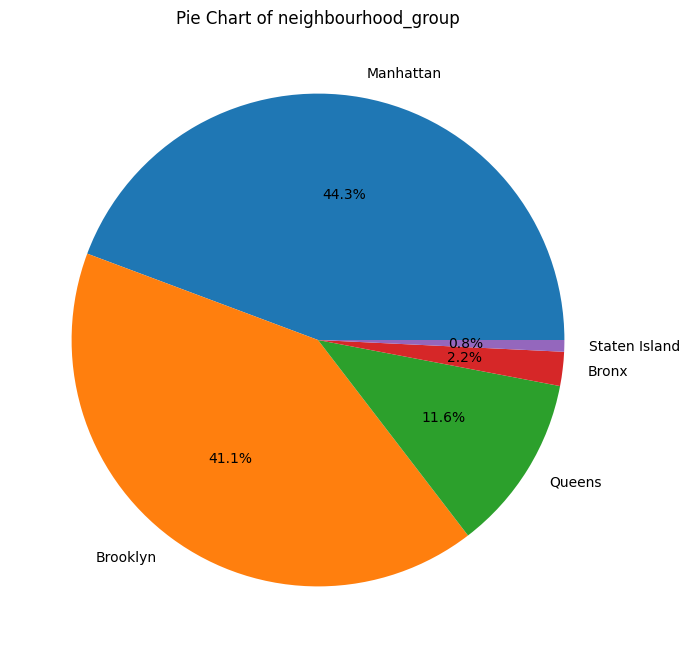

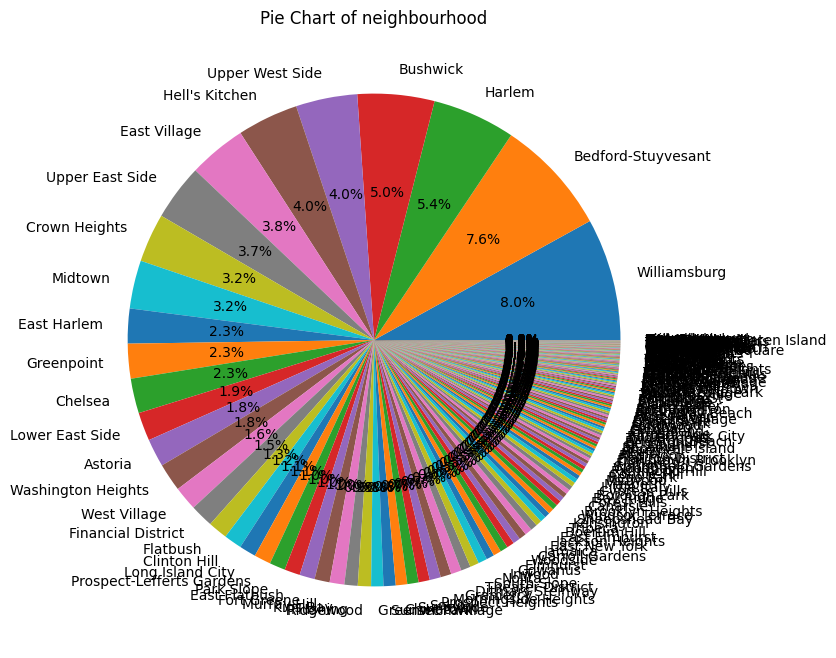

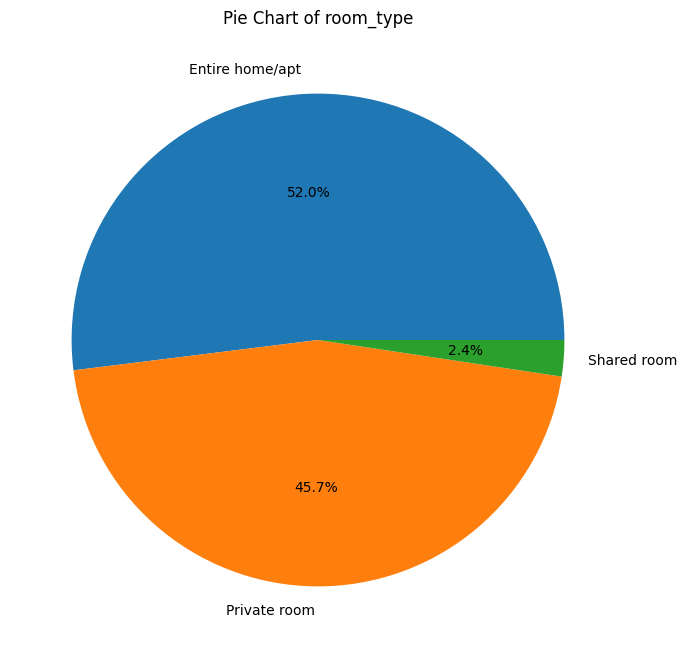

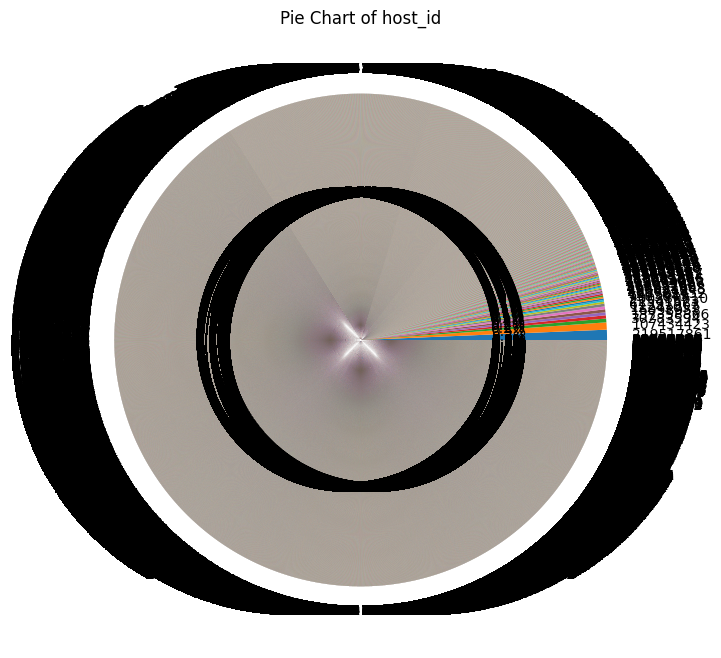

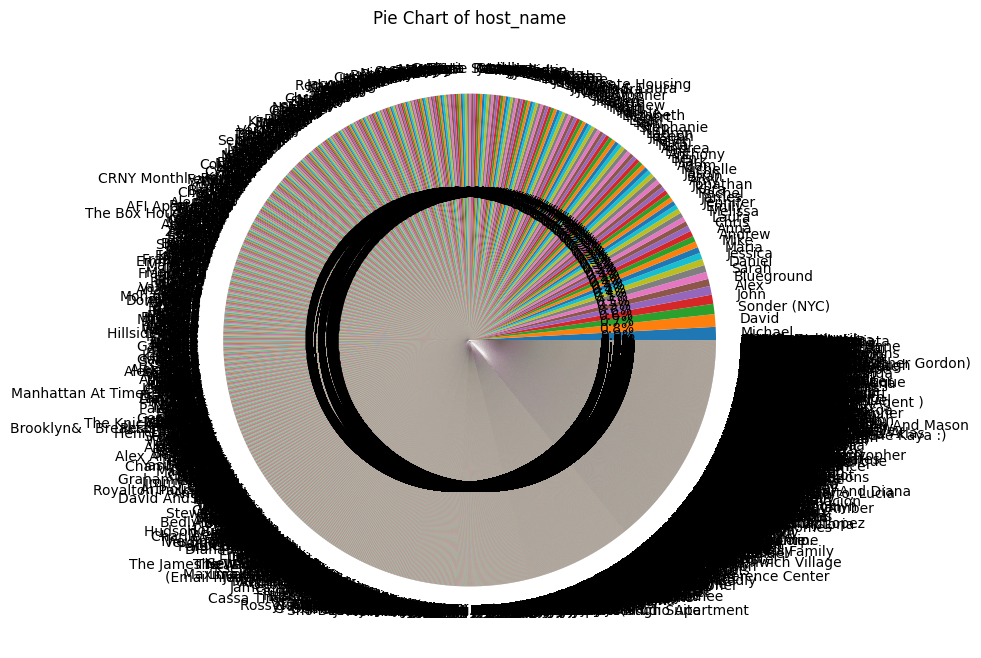

In [ ]:
for column in columns2:
    plt.figure(figsize=(8, 8))
    df[column].value_counts().plot(kind='pie', autopct='%1.1f%%')
    plt.title(f'Pie Chart of {column}')
    plt.ylabel('')  # Remove the y-label
    plt.show()

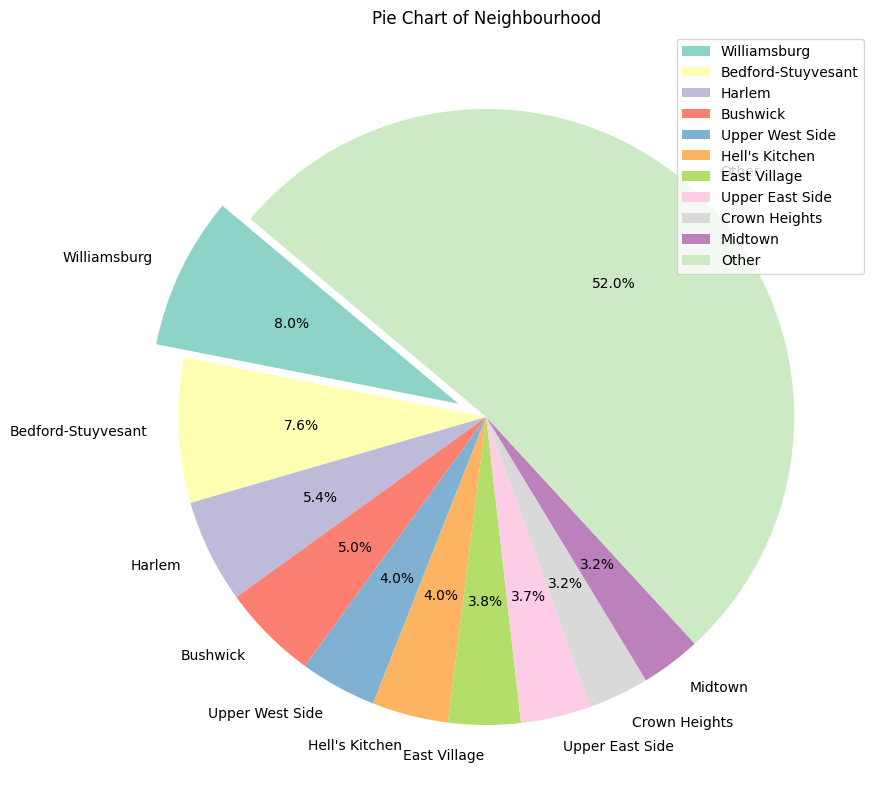

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Correct any potential naming conflict
del range  # Ensure that range isn't overridden by a variable

plt.figure(figsize=(10, 10))

# Limit to top 10 neighborhoods + 'Other' category
top_neighborhoods = df['neighbourhood'].value_counts().nlargest(10)
other_neighborhoods = pd.Series({'Other': df['neighbourhood'].value_counts().iloc[10:].sum()})
data = pd.concat([top_neighborhoods, other_neighborhoods])

# Explode the largest slice for emphasis
explode = [0.1 if i == 0 else 0 for i in range(len(data))]

# Use a color palette
colors = sns.color_palette('Set3', len(data))

# Plot the pie chart
data.plot(kind='pie', autopct='%1.1f%%', explode=explode, colors=colors, startangle=140)

plt.title('Pie Chart of Neighbourhood')
plt.ylabel('')  # Remove the y-label

# Add a legend
plt.legend(data.index, loc="best")

plt.show()


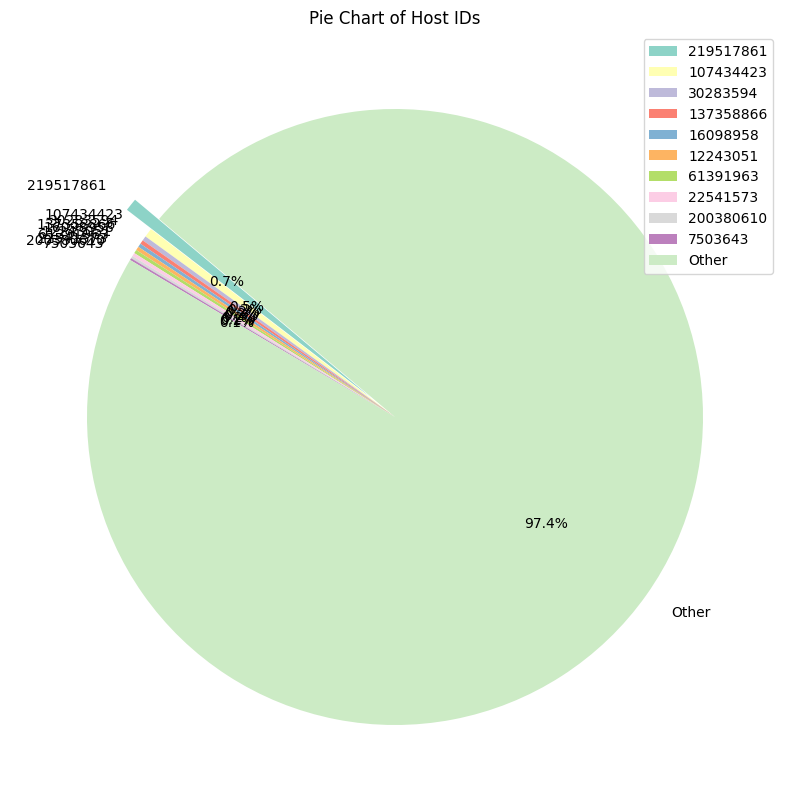

In [ ]:
plt.figure(figsize=(10, 10))

# Limit to top 10 host_ids + 'Other' category
top_hosts = df['host_id'].value_counts().nlargest(10)
other_hosts = pd.Series({'Other': df['host_id'].value_counts().iloc[10:].sum()})
data = pd.concat([top_hosts, other_hosts])

# Explode the largest slice for emphasis
explode = [0.1 if i == 0 else 0 for i in range(len(data))]

# Use a color palette
colors = sns.color_palette('Set3', len(data))

# Plot the pie chart
data.plot(kind='pie', autopct='%1.1f%%', explode=explode, colors=colors, startangle=140)

plt.title('Pie Chart of Host IDs')
plt.ylabel('')  # Remove the y-label

# Add a legend
plt.legend(data.index, loc="best")

plt.show()

Countplot

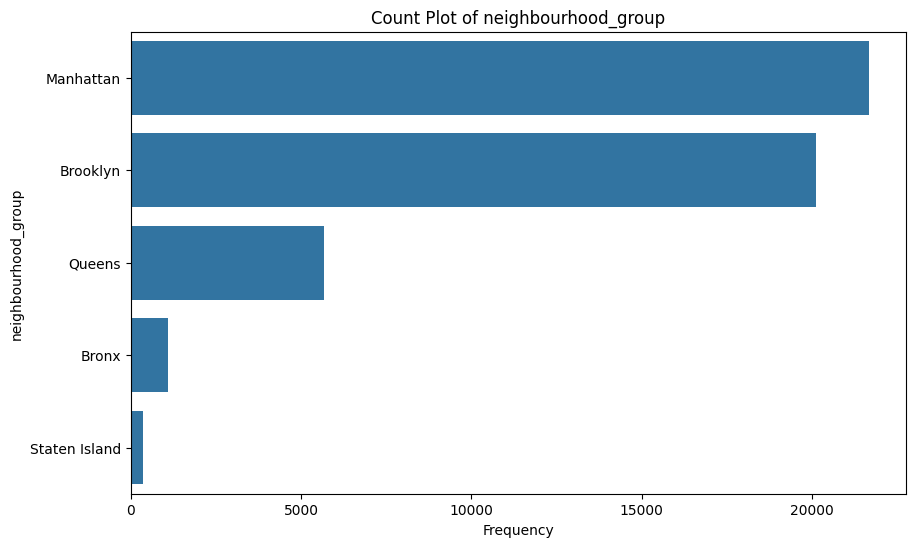

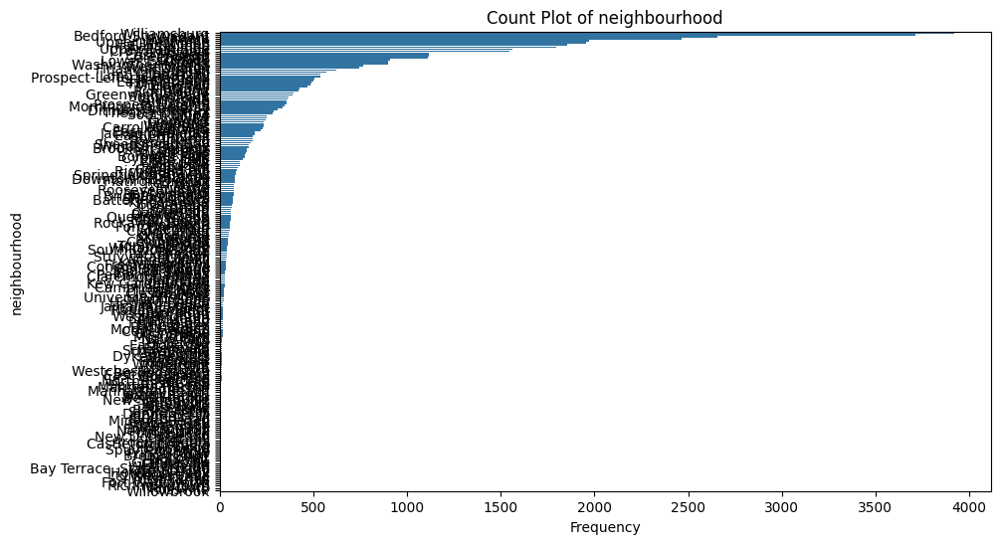

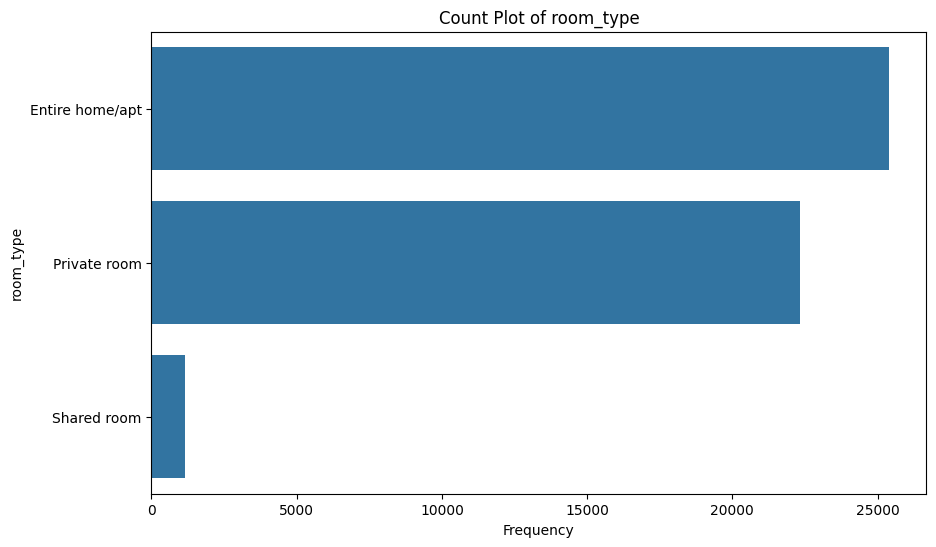

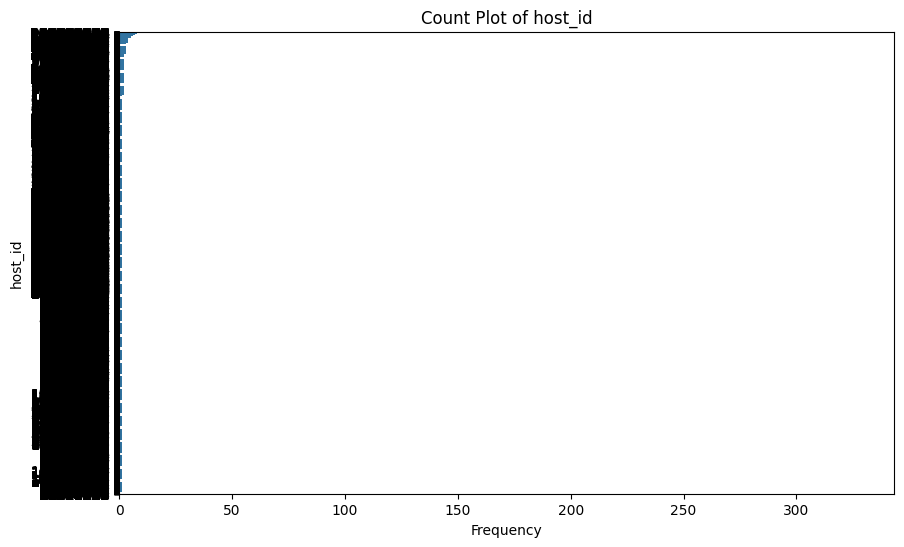

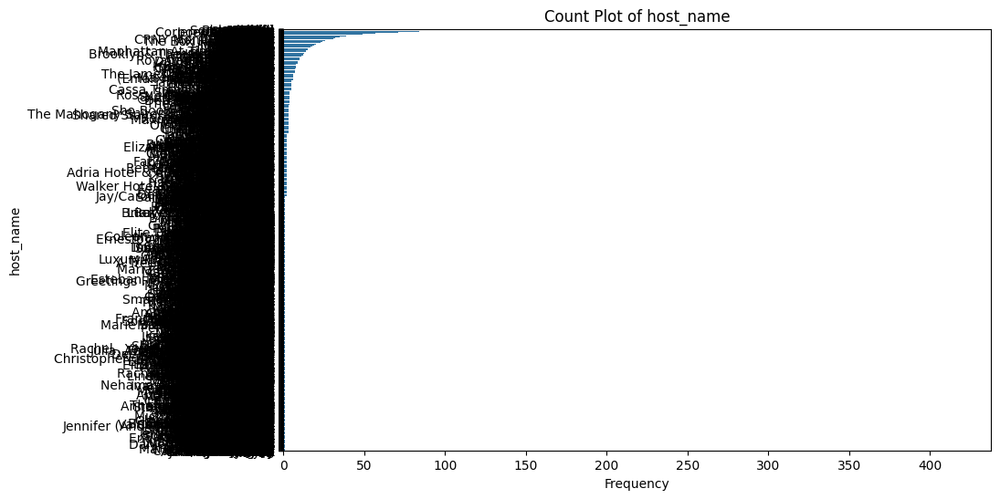

In [ ]:
for column in columns2:
    plt.figure(figsize=(10, 6))
    sns.countplot(y=column, data=df, order=df[column].value_counts().index)
    plt.title(f'Count Plot of {column}')
    plt.xlabel('Frequency')
    plt.ylabel(column)
    plt.show()

# **Diabetes Dataset**

In [ ]:
from sklearn.datasets import load_diabetes
diabetes = load_diabetes()
df = pd.DataFrame(diabetes.data, columns=diabetes.feature_names)

In [ ]:
columns = ['age', 'bmi', 'bp', 's1', 's2', 's3', 's4', 's5', 's6']
df[columns].describe()

,age,bmi,bp,s1,s2,s3,s4,s5,s6
count,4.420000e+02,4.420000e+02,4.420000e+02,4.420000e+02,4.420000e+02,4.420000e+02,4.420000e+02,4.420000e+02,4.420000e+02
mean,-2.511817e-19,-2.245564e-16,-4.797570e-17,-1.381499e-17,3.918434e-17,-5.777179e-18,-9.042540e-18,9.293722e-17,1.130318e-17
std,4.761905e-02,4.761905e-02,4.761905e-02,4.761905e-02,4.761905e-02,4.761905e-02,4.761905e-02,4.761905e-02,4.761905e-02
min,-1.072256e-01,-9.027530e-02,-1.123988e-01,-1.267807e-01,-1.156131e-01,-1.023071e-01,-7.639450e-02,-1.260971e-01,-1.377672e-01
25%,-3.729927e-02,-3.422907e-02,-3.665608e-02,-3.424784e-02,-3.035840e-02,-3.511716e-02,-3.949338e-02,-3.324559e-02,-3.317903e-02
50%,5.383060e-03,-7.283766e-03,-5.670422e-03,-4.320866e-03,-3.819065e-03,-6.584468e-03,-2.592262e-03,-1.947171e-03,-1.077698e-03
75%,3.807591e-02,3.124802e-02,3.564379e-02,2.835801e-02,2.984439e-02,2.931150e-02,3.430886e-02,3.243232e-02,2.791705e-02
max,1.107267e-01,1.705552e-01,1.320436e-01,1.539137e-01,1.987880e-01,1.811791e-01,1.852344e-01,1.335973e-01,1.356118e-01


Dataset is already standardized hence the -x.0000ye-0z outputs